### **Context**

UK police forces collect data on every vehicle collision in the uk on a form called Stats19. Data from this form ends up at the DfT and is published at https://data.gov.uk/dataset/road-accidents-safety-data

### Content
The data set is in db formate. It's having three main tables.  Accidents is the primary one and has references by Accident_Index to the casualties and vehicles tables. This might be better done as a database.

### **Inspiration**

Questions to ask of this data -

* combined with population data, how do different areas compare?
* what trends are there for accidents involving different road users eg motorcycles, peds, cyclists are road safety campaigns effective?
* likelihood of accidents for different groups / vehicles


### Import Required Libaries

In [1]:
import sqlite3
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import folium
from folium import plugins
from folium.plugins import HeatMap
plt.style.use('ggplot')
import warnings
warnings.filterwarnings('ignore')

### Import Dataset

In [2]:

# Replace 'your_database.db' with the path to your .db file
db_path = 'data/accident_data_v1.0.0_2023.db'

# Connect to the SQLite database
conn = sqlite3.connect(db_path)

# Create a cursor object to execute SQL queries
cursor = conn.cursor()

# Query the sqlite_master table to get the table names
cursor.execute("SELECT name FROM sqlite_master WHERE type='table';")

# Fetch all the table names
table_names = cursor.fetchall()


# Extract the table names from the result
table_names = [table[0] for table in table_names]

# Print the list of table names
print("Tables in the database:")
for table_name in table_names:
    print(table_name)

Tables in the database:
accident
casualty
vehicle
lsoa


### Accidents

In [3]:

query = 'SELECT * FROM accident'
accidents = pd.read_sql(query, conn)

In [4]:
accidents.head()

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location
0,2017010001708,2017,010001708,532920.0,196330.0,-0.080107,51.650061,1,1,2,...,0,4,1,1,0,0,1,1,2,E01001450
1,2017010009342,2017,010009342,526790.0,181970.0,-0.173845,51.522425,1,3,2,...,0,4,1,2,0,0,1,1,2,E01004702
2,2017010009344,2017,010009344,535200.0,181260.0,-0.052969,51.514096,1,3,3,...,0,4,1,1,0,0,1,1,2,E01004298
3,2017010009348,2017,010009348,534340.0,193560.0,-0.060658,51.624832,1,3,2,...,4,4,2,2,0,0,1,1,2,E01001429
4,2017010009350,2017,010009350,533680.0,187820.0,-0.072372,51.573408,1,2,1,...,5,4,1,2,0,0,1,1,2,E01001808


### Casualties

In [5]:
query = 'SELECT * FROM casualty'
casualities = pd.read_sql(query, conn)
casualities

,casualty_index,accident_index,accident_year,accident_reference,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile
0,0,2017010001708,2017,010001708,1,1,2,2,18,4,3,0,0,1,0,0,9,1,2
1,1,2017010001708,2017,010001708,2,2,1,1,19,4,2,0,0,0,0,0,2,-1,-1
2,2,2017010001708,2017,010001708,2,3,2,1,18,4,1,0,0,0,0,0,2,-1,-1
3,3,2017010009342,2017,010009342,1,1,2,2,33,6,3,0,0,1,0,0,9,1,5
4,4,2017010009344,2017,010009344,3,1,1,2,31,6,3,0,0,0,0,0,9,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
600327,600327,2020991027064,2020,991027064,2,1,1,1,11,3,2,0,0,0,0,0,1,1,2
600328,600328,2020991029573,2020,991029573,1,1,3,2,63,9,3,10,1,0,0,0,0,1,10
600329,600329,2020991030297,2020,991030297,2,1,1,1,38,7,2,0,0,0,0,0,5,2,9
600330,600330,2020991030900,2020,991030900,2,1,1,1,76,11,3,0,0,0,0,0,1,1,9


### Vehicle

In [6]:
query = 'SELECT * FROM vehicle'
vehicles = pd.read_sql(query, conn)
vehicles

,vehicle_index,accident_index,accident_year,accident_reference,vehicle_reference,vehicle_type,towing_and_articulation,vehicle_manoeuvre,vehicle_direction_from,vehicle_direction_to,...,journey_purpose_of_driver,sex_of_driver,age_of_driver,age_band_of_driver,engine_capacity_cc,propulsion_code,age_of_vehicle,generic_make_model,driver_imd_decile,driver_home_area_type
0,0,2017010001708,2017,010001708,1,9,0,18,1,5,...,6,1,24,5,1997,2,1,-1,-1,-1
1,1,2017010001708,2017,010001708,2,2,0,18,1,5,...,6,1,19,4,-1,-1,-1,-1,-1,-1
2,2,2017010009342,2017,010009342,1,9,0,18,5,1,...,6,1,33,6,1797,8,8,-1,9,1
3,3,2017010009342,2017,010009342,2,9,0,18,5,1,...,6,1,40,7,2204,2,12,-1,2,1
4,4,2017010009344,2017,010009344,1,9,0,18,3,7,...,6,3,-1,-1,-1,-1,-1,-1,-1,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
849086,849086,2020991030297,2020,991030297,1,9,0,7,8,2,...,1,1,57,9,1968,2,2,AUDI A5,7,1
849087,849087,2020991030297,2020,991030297,2,5,0,16,6,2,...,5,1,38,7,1301,1,2,KTM 1290 SUPERDUKE,9,2
849088,849088,2020991030900,2020,991030900,1,9,0,7,8,2,...,6,2,68,10,1995,2,1,BMW X3,5,1
849089,849089,2020991030900,2020,991030900,2,1,0,18,6,2,...,6,1,76,11,-1,-1,-1,-1,9,1


In [7]:
# Close the cursor and connection
cursor.close()
conn.close()

## Perform Some Basic Analysis

## Accidents

In [8]:
#check data types of accidents dataframe
accidents.dtypes

accident_index                                  object
accident_year                                    int64
accident_reference                              object
location_easting_osgr                          float64
location_northing_osgr                         float64
longitude                                      float64
latitude                                       float64
police_force                                     int64
accident_severity                                int64
number_of_vehicles                               int64
number_of_casualties                             int64
date                                            object
day_of_week                                      int64
time                                            object
local_authority_district                         int64
local_authority_ons_district                    object
local_authority_highway                         object
first_road_class                                 int64
first_road

In [9]:
# check if there is any null value
accidents.isna().sum()

accident_index                                   0
accident_year                                    0
accident_reference                               0
location_easting_osgr                          116
location_northing_osgr                         116
longitude                                      126
latitude                                       126
police_force                                     0
accident_severity                                0
number_of_vehicles                               0
number_of_casualties                             0
date                                             0
day_of_week                                      0
time                                             0
local_authority_district                         0
local_authority_ons_district                     0
local_authority_highway                          0
first_road_class                                 0
first_road_number                                0
road_type                      

We have some null values in few columns

In [10]:

print("Number of rows present in a dataset    :{}".format(accidents.shape[0]))
print("Number of columns present in a dataset :{}".format(accidents.shape[1]))

Number of rows present in a dataset    :461352
Number of columns present in a dataset :36


In [11]:
accidents.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 461352 entries, 0 to 461351
Data columns (total 36 columns):
 #   Column                                       Non-Null Count   Dtype  
---  ------                                       --------------   -----  
 0   accident_index                               461352 non-null  object 
 1   accident_year                                461352 non-null  int64  
 2   accident_reference                           461352 non-null  object 
 3   location_easting_osgr                        461236 non-null  float64
 4   location_northing_osgr                       461236 non-null  float64
 5   longitude                                    461226 non-null  float64
 6   latitude                                     461226 non-null  float64
 7   police_force                                 461352 non-null  int64  
 8   accident_severity                            461352 non-null  int64  
 9   number_of_vehicles                           461352 non-nul

* Date and time should be datetime instead of object.

In [12]:
pd.set_option('display.max_columns', 36)

In [13]:
accidents.head()

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location
0,2017010001708,2017,010001708,532920.0,196330.0,-0.080107,51.650061,1,1,2,3,05/08/2017,7,03:12,32,E09000010,E09000010,3,105,6,30,0,-1,-1,-1,0,0,4,1,1,0,0,1,1,2,E01001450
1,2017010009342,2017,010009342,526790.0,181970.0,-0.173845,51.522425,1,3,2,1,01/01/2017,1,01:30,1,E09000033,E09000033,3,5,6,30,3,4,6,0,0,0,4,1,2,0,0,1,1,2,E01004702
2,2017010009344,2017,010009344,535200.0,181260.0,-0.052969,51.514096,1,3,3,1,01/01/2017,1,00:30,5,E09000030,E09000030,3,13,6,30,3,4,5,0,0,0,4,1,1,0,0,1,1,2,E01004298
3,2017010009348,2017,010009348,534340.0,193560.0,-0.060658,51.624832,1,3,2,1,01/01/2017,1,01:11,32,E09000010,E09000010,3,1010,1,30,1,4,4,154,0,4,4,2,2,0,0,1,1,2,E01001429
4,2017010009350,2017,010009350,533680.0,187820.0,-0.072372,51.573408,1,2,1,1,01/01/2017,1,01:42,4,E09000012,E09000012,3,107,3,20,6,2,3,10,0,5,4,1,2,0,0,1,1,2,E01001808


#### Add new features that may help us better analyze the topic

In [14]:
accidents["date"] = pd.to_datetime(accidents["date"], format='%d/%m/%Y')
accidents["day"] = accidents["date"].dt.day
accidents["month"] = accidents["date"].dt.month
accidents["weekday"] = accidents["date"].dt.day_name()
accidents["time"] = accidents["time"].astype("datetime64[ns]")
accidents["hour"] = accidents["time"].dt.hour
accidents["time"] = accidents["time"].dt.time

In [15]:
pd.set_option('display.max_columns', 38)

In [16]:
accidents.head()

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,...,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,day,month,weekday,hour
0,2017010001708,2017,010001708,532920.0,196330.0,-0.080107,51.650061,1,1,2,3,2017-08-05,7,03:12:00,32,E09000010,E09000010,3,105,...,0,-1,-1,-1,0,0,4,1,1,0,0,1,1,2,E01001450,5,8,Saturday,3
1,2017010009342,2017,010009342,526790.0,181970.0,-0.173845,51.522425,1,3,2,1,2017-01-01,1,01:30:00,1,E09000033,E09000033,3,5,...,3,4,6,0,0,0,4,1,2,0,0,1,1,2,E01004702,1,1,Sunday,1
2,2017010009344,2017,010009344,535200.0,181260.0,-0.052969,51.514096,1,3,3,1,2017-01-01,1,00:30:00,5,E09000030,E09000030,3,13,...,3,4,5,0,0,0,4,1,1,0,0,1,1,2,E01004298,1,1,Sunday,0
3,2017010009348,2017,010009348,534340.0,193560.0,-0.060658,51.624832,1,3,2,1,2017-01-01,1,01:11:00,32,E09000010,E09000010,3,1010,...,1,4,4,154,0,4,4,2,2,0,0,1,1,2,E01001429,1,1,Sunday,1
4,2017010009350,2017,010009350,533680.0,187820.0,-0.072372,51.573408,1,2,1,1,2017-01-01,1,01:42:00,4,E09000012,E09000012,3,107,...,6,2,3,10,0,5,4,1,2,0,0,1,1,2,E01001808,1,1,Sunday,1


In [17]:
#replace codes to categories
accidents = accidents.replace({'accident_severity': {1: 'Low', 2: 'Normal', 3:'High'}})

In [18]:
# total number of rows having null values
accidents[accidents.isna().any(axis=1)]

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,...,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,day,month,weekday,hour
28222,201704ED17168,2017,04ED17168,NaN,NaN,NaN,NaN,4,High,3,1,2017-05-15,2,12:48:00,70,E06000008,E06000008,6,0,...,9,4,6,0,0,0,1,1,1,0,0,3,1,2,-1,15,5,Monday,12
28865,201704EF17292,2017,04EF17292,NaN,NaN,NaN,NaN,4,High,2,1,2017-12-08,6,18:00:00,82,E07000125,E10000017,3,56,...,0,-1,-1,-1,0,0,4,9,-1,0,0,3,1,2,-1,8,12,Friday,18
30154,201704SC17240,2017,04SC17240,NaN,NaN,NaN,NaN,4,High,2,3,2017-10-07,7,16:30:00,73,E07000118,E10000017,3,581,...,1,4,6,0,0,4,1,2,2,0,0,2,1,2,E01024923,7,10,Saturday,16
30411,201704WA17179,2017,04WA17179,NaN,NaN,NaN,NaN,4,High,2,1,2017-05-28,1,00:45:00,74,E07000119,E10000017,3,586,...,0,-1,-1,-1,0,0,4,2,2,0,0,2,1,2,E01025027,28,5,Sunday,0
39550,2017077353971,2017,077353971,NaN,NaN,NaN,NaN,7,High,3,1,2017-11-02,5,13:15:00,130,E06000050,E06000050,3,54,...,6,4,4,54,0,0,1,1,1,0,0,2,1,2,E01018680,2,11,Thursday,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456858,202063A035620,2020,63A035620,NaN,NaN,NaN,NaN,63,High,1,1,2020-06-10,4,18:35:00,-1,W06000010,W06000010,6,0,...,0,-1,0,-1,0,0,1,1,1,0,0,3,2,-1,-1,10,6,Wednesday,18
456938,202063A059120,2020,63A059120,NaN,NaN,NaN,NaN,63,High,2,1,2020-08-28,6,10:15:00,-1,W06000010,W06000010,4,4300,...,0,-1,0,-1,0,0,1,1,1,0,0,3,2,-1,-1,28,8,Friday,10
457171,202063C020320,2020,63C020320,NaN,NaN,NaN,NaN,63,High,2,2,2020-02-26,4,18:30:00,752,W06000009,W06000009,6,0,...,3,4,6,0,0,0,7,1,1,0,0,3,2,-1,-1,26,2,Wednesday,18
457183,202063C024520,2020,63C024520,NaN,NaN,NaN,NaN,63,Normal,2,1,2020-03-22,1,14:15:00,752,W06000009,W06000009,6,0,...,0,-1,0,-1,0,0,1,1,1,0,0,3,2,-1,-1,22,3,Sunday,14


There are total 126 number of rows having null values

#### Drop a column that have several missing values and all the other missing values



In [19]:
#drop null values
accidents.dropna(inplace=True)

In [20]:
#check if there are any duplicate values
accidents.duplicated().sum()

0

There isn't any duplicate value in accidents table. 

In [21]:
# Test now if columns have correct data types
accidents.info()

<class 'pandas.core.frame.DataFrame'>
Index: 461226 entries, 0 to 461351
Data columns (total 40 columns):
 #   Column                                       Non-Null Count   Dtype         
---  ------                                       --------------   -----         
 0   accident_index                               461226 non-null  object        
 1   accident_year                                461226 non-null  int64         
 2   accident_reference                           461226 non-null  object        
 3   location_easting_osgr                        461226 non-null  float64       
 4   location_northing_osgr                       461226 non-null  float64       
 5   longitude                                    461226 non-null  float64       
 6   latitude                                     461226 non-null  float64       
 7   police_force                                 461226 non-null  int64         
 8   accident_severity                            461226 non-null  object 

In [22]:
#check if there is any null value left
accidents.isnull().sum()

accident_index                                 0
accident_year                                  0
accident_reference                             0
location_easting_osgr                          0
location_northing_osgr                         0
longitude                                      0
latitude                                       0
police_force                                   0
accident_severity                              0
number_of_vehicles                             0
number_of_casualties                           0
date                                           0
day_of_week                                    0
time                                           0
local_authority_district                       0
local_authority_ons_district                   0
local_authority_highway                        0
first_road_class                               0
first_road_number                              0
road_type                                      0
speed_limit         

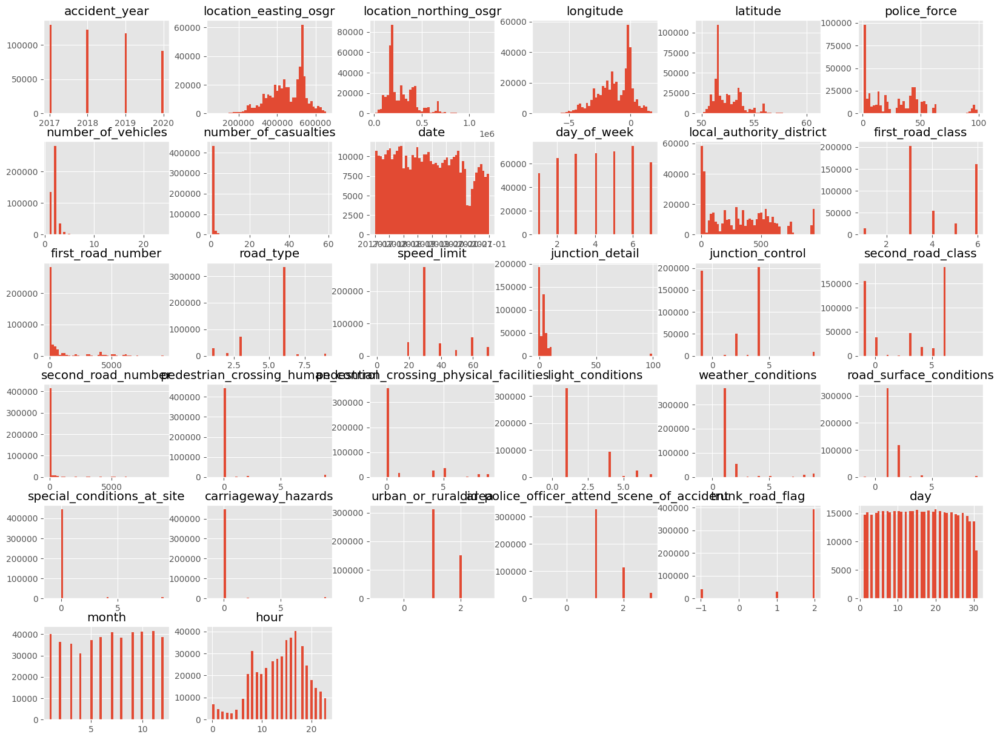

In [23]:
accidents.hist(bins = 50, figsize = (20,15))
plt.show()

In [24]:
print("Number of rows present in a dataset after preprocessing     :{}".format(accidents.shape[0]))
print("Number of columns present in a dataset after preprocessing  :{}".format(accidents.shape[1]))

Number of rows present in a dataset after preprocessing     :461226
Number of columns present in a dataset after preprocessing  :40


In [25]:
accidents['accident_index'] = accidents['accident_index'].astype(str)
accidents['accident_reference'] = accidents['accident_reference'].astype(str)
accidents['local_authority_ons_district'] = accidents['local_authority_ons_district'].astype(str)
accidents['local_authority_highway'] = accidents['local_authority_highway'].astype(str)

In [26]:
accidents.head()

,accident_index,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,time,local_authority_district,local_authority_ons_district,local_authority_highway,first_road_class,first_road_number,...,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,day,month,weekday,hour
0,2017010001708,2017,010001708,532920.0,196330.0,-0.080107,51.650061,1,Low,2,3,2017-08-05,7,03:12:00,32,E09000010,E09000010,3,105,...,0,-1,-1,-1,0,0,4,1,1,0,0,1,1,2,E01001450,5,8,Saturday,3
1,2017010009342,2017,010009342,526790.0,181970.0,-0.173845,51.522425,1,High,2,1,2017-01-01,1,01:30:00,1,E09000033,E09000033,3,5,...,3,4,6,0,0,0,4,1,2,0,0,1,1,2,E01004702,1,1,Sunday,1
2,2017010009344,2017,010009344,535200.0,181260.0,-0.052969,51.514096,1,High,3,1,2017-01-01,1,00:30:00,5,E09000030,E09000030,3,13,...,3,4,5,0,0,0,4,1,1,0,0,1,1,2,E01004298,1,1,Sunday,0
3,2017010009348,2017,010009348,534340.0,193560.0,-0.060658,51.624832,1,High,2,1,2017-01-01,1,01:11:00,32,E09000010,E09000010,3,1010,...,1,4,4,154,0,4,4,2,2,0,0,1,1,2,E01001429,1,1,Sunday,1
4,2017010009350,2017,010009350,533680.0,187820.0,-0.072372,51.573408,1,Normal,1,1,2017-01-01,1,01:42:00,4,E09000012,E09000012,3,107,...,6,2,3,10,0,5,4,1,2,0,0,1,1,2,E01001808,1,1,Sunday,1


In [27]:
# Calculate correlation for numeric columns only
numeric_columns = accidents.select_dtypes(include='number')
numeric_columns.corr()

,accident_year,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,number_of_vehicles,number_of_casualties,day_of_week,local_authority_district,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,day,month,hour
accident_year,1.000000,0.018277,-0.023397,0.018612,-0.023399,-0.013472,-0.001648,-0.020794,0.003266,-0.020673,-0.003712,0.007556,0.017821,-0.024986,0.047494,0.003643,0.039894,0.002883,0.039890,0.024180,0.007538,0.011956,-0.006923,0.003605,-0.005756,-0.003711,0.109177,0.022220,-0.002820,0.010730,0.011487
location_easting_osgr,0.018277,1.000000,-0.424618,0.999426,-0.426988,-0.367444,0.019293,-0.035271,0.002598,-0.393077,-0.019116,-0.162071,-0.019727,-0.102934,0.084469,0.078016,0.055545,-0.069538,0.139244,0.128389,0.014783,0.008977,0.027391,0.076805,0.079779,-0.114973,0.108460,0.503264,0.000426,0.004830,-0.004623
location_northing_osgr,-0.023397,-0.424618,1.000000,-0.433252,0.999970,0.154820,-0.024128,0.028764,0.002062,0.117421,0.023942,0.076591,0.013132,0.083321,-0.066812,-0.065408,-0.047867,0.045138,-0.108436,-0.081627,-0.011697,0.000706,-0.018671,-0.061025,-0.063876,0.047090,-0.029798,-0.437407,0.001524,-0.006652,0.008841
longitude,0.018612,0.999426,-0.433252,1.000000,-0.435534,-0.378360,0.019688,-0.034633,0.002475,-0.400985,-0.017200,-0.160333,-0.019287,-0.101842,0.083065,0.077069,0.055044,-0.069125,0.137287,0.126105,0.014731,0.008389,0.026101,0.075593,0.078403,-0.112440,0.107982,0.517999,0.000315,0.004965,-0.004779
latitude,-0.023399,-0.426988,0.999970,-0.435534,1.000000,0.153007,-0.024027,0.028763,0.002056,0.116026,0.023854,0.077651,0.012983,0.082986,-0.066925,-0.065163,-0.047523,0.045693,-0.108794,-0.081626,-0.011686,0.000609,-0.018912,-0.061252,-0.064123,0.046562,-0.030029,-0.435764,0.001485,-0.006679,0.008881
police_force,-0.013472,-0.367444,0.154820,-0.378360,0.153007,1.000000,0.008839,0.041369,-0.003663,0.976541,0.040390,0.005145,0.017880,0.250370,-0.136935,-0.145409,-0.120719,-0.023841,-0.185518,-0.200717,-0.009110,-0.045405,-0.046429,-0.105670,-0.101075,0.271934,-0.123672,-0.655575,0.003484,-0.006314,-0.019321
number_of_vehicles,-0.001648,0.019293,-0.024128,0.019688,-0.024027,0.008839,1.000000,0.218596,0.000017,0.012290,-0.127486,-0.000439,-0.071448,0.100070,-0.004213,0.035741,0.039336,0.010836,-0.025736,-0.061377,-0.063970,-0.038550,-0.048276,-0.029604,-0.041842,0.049250,-0.034264,-0.012214,0.003386,-0.000199,0.006391
number_of_casualties,-0.020794,-0.035271,0.028764,-0.034633,0.028763,0.041369,0.218596,1.000000,-0.001038,0.047606,-0.086319,0.014026,-0.017755,0.164592,-0.028255,-0.047745,-0.039955,0.005144,-0.043820,-0.053668,0.027640,-0.024166,-0.010812,-0.025023,-0.026644,0.131740,-0.103435,-0.039207,0.005364,-0.000750,0.020120
day_of_week,0.003266,0.002598,0.002062,0.002475,0.002056,-0.003663,0.000017,-0.001038,1.000000,-0.003986,0.005516,0.000608,0.004830,-0.016423,0.004753,0.006113,0.008484,-0.000612,0.001638,0.003949,0.011623,0.005590,0.005563,0.001984,0.000434,-0.017229,0.003957,0.002915,0.007946,0.002338,0.040095
local_authority_district,-0.020673,-0.393077,0.117421,-0.400985,0.116026,0.976541,0.012290,0.047606,-0.003986,1.000000,0.051609,0.018399,0.020757,0.260994,-0.148254,-0.152958,-0.125117,-0.019000,-0.204112,-0.220605,-0.009655,-0.049931,-0.055129,-0.116647,-0.112156,0.287803,-0.128015,-0.614623,0.003407,-0.008591,-0.020146


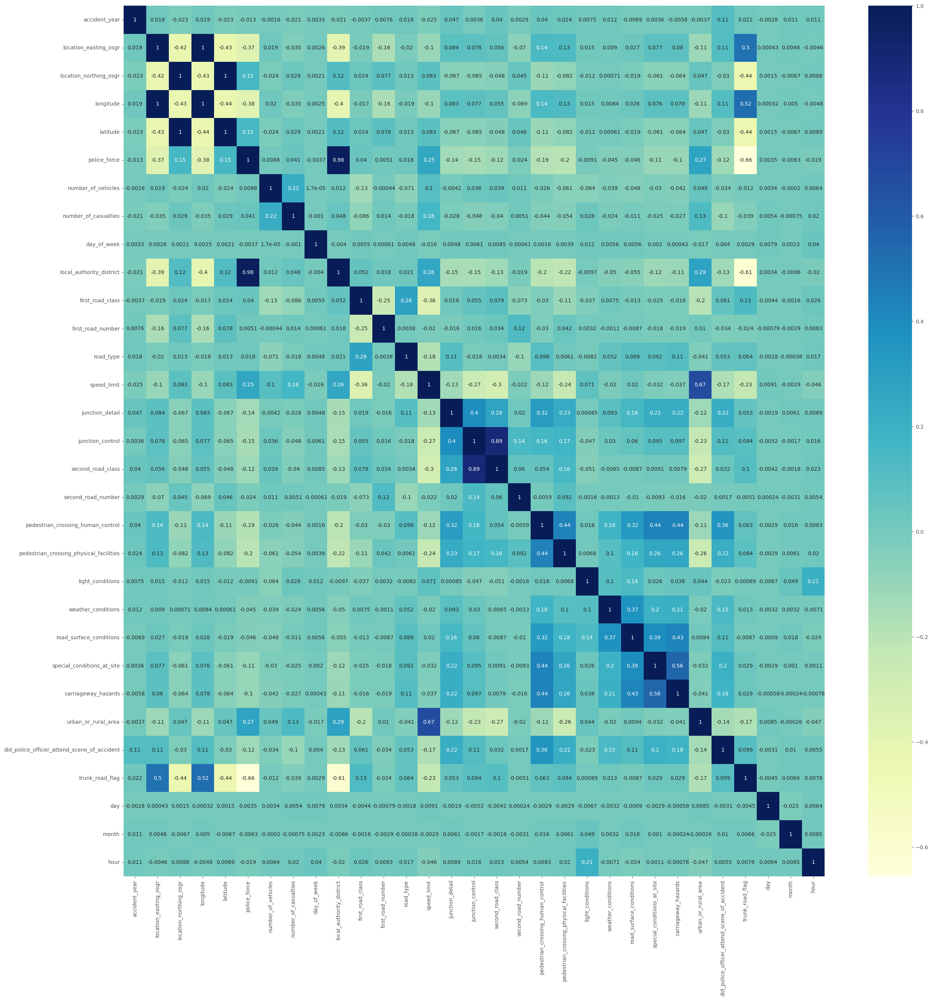

In [28]:
plt.figure(figsize = (30,30))
sns_plot = sns.heatmap(data = numeric_columns.corr(),annot = True, cmap = "YlGnBu")
sns_plot.figure.savefig("output1.png")
plt.show()

**Observation**

There are some general observations we can make based on the provided correlation values. Here are some key points to consider:

* **Geographic Coordinates:** The columns related to location (easting_osgr, northing_osgr, longitude, latitude) have strong positive correlations with each other, as expected. These features represent different representations of the same location information.

* **Police Force and Casualties:** The number of casualties and the police force attending the scene of the accident show a moderate positive correlation. This suggests that more severe accidents (higher casualties) might be more likely to attract police presence.

* **Urban or Rural Area:** The column indicating whether the accident occurred in an urban or rural area has a moderate negative correlation with the police force attending the scene. This indicates that accidents in rural areas might be less likely to have police presence compared to urban areas.

* **Trunk Road Flag:** The trunk road flag has a strong positive correlation with the location-related columns (easting_osgr, northing_osgr, longitude, latitude). This indicates that trunk roads are likely to have specific geographic coordinates associated with them.

* **Junction Details:** The junction details show interesting correlations. For example, the junction control and the second road class have moderate positive correlations with each other, suggesting that specific types of junctions might be associated with certain types of roads.

* **Weather Conditions and Road Surface:** Weather conditions and road surface conditions have positive correlations, indicating that certain weather conditions might lead to specific road surface conditions.

* **Speed Limit and Weather Conditions:** The speed limit and weather conditions have a weak negative correlation, suggesting that certain weather conditions might lead to lower speed limits on the roads.

* **Month and Trunk Road Flag:** The month and trunk road flag have a small positive correlation, indicating that certain months might see more accidents on trunk roads.

## Casualities

In [29]:
casualities.head()

,casualty_index,accident_index,accident_year,accident_reference,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile
0,0,2017010001708,2017,010001708,1,1,2,2,18,4,3,0,0,1,0,0,9,1,2
1,1,2017010001708,2017,010001708,2,2,1,1,19,4,2,0,0,0,0,0,2,-1,-1
2,2,2017010001708,2017,010001708,2,3,2,1,18,4,1,0,0,0,0,0,2,-1,-1
3,3,2017010009342,2017,010009342,1,1,2,2,33,6,3,0,0,1,0,0,9,1,5
4,4,2017010009344,2017,010009344,3,1,1,2,31,6,3,0,0,0,0,0,9,1,5


In [30]:
print("Number of rows present in a dataset    :{}".format(casualities.shape[0]))
print("Number of columns present in a dataset :{}".format(casualities.shape[1]))

Number of rows present in a dataset    :600332
Number of columns present in a dataset :19


In [31]:
casualities.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600332 entries, 0 to 600331
Data columns (total 19 columns):
 #   Column                              Non-Null Count   Dtype 
---  ------                              --------------   ----- 
 0   casualty_index                      600332 non-null  int64 
 1   accident_index                      600332 non-null  object
 2   accident_year                       600332 non-null  int64 
 3   accident_reference                  600332 non-null  object
 4   vehicle_reference                   600332 non-null  int64 
 5   casualty_reference                  600332 non-null  int64 
 6   casualty_class                      600332 non-null  int64 
 7   sex_of_casualty                     600332 non-null  int64 
 8   age_of_casualty                     600332 non-null  int64 
 9   age_band_of_casualty                600332 non-null  int64 
 10  casualty_severity                   600332 non-null  int64 
 11  pedestrian_location                 600

In [32]:
#check if there is any null value
casualities.isnull().sum()

casualty_index                        0
accident_index                        0
accident_year                         0
accident_reference                    0
vehicle_reference                     0
casualty_reference                    0
casualty_class                        0
sex_of_casualty                       0
age_of_casualty                       0
age_band_of_casualty                  0
casualty_severity                     0
pedestrian_location                   0
pedestrian_movement                   0
car_passenger                         0
bus_or_coach_passenger                0
pedestrian_road_maintenance_worker    0
casualty_type                         0
casualty_home_area_type               0
casualty_imd_decile                   0
dtype: int64

In [33]:
#check if there is any duplicate value
casualities.duplicated().sum()

0

In [34]:
casualities.describe().T

,count,mean,std,min,25%,50%,75%,max
casualty_index,600332.0,300165.500000,173301.065238,0.0,150082.75,300165.5,450248.25,600331.0
accident_year,600332.0,2018.355358,1.088030,2017.0,2017.00,2018.0,2019.00,2020.0
vehicle_reference,600332.0,1.473603,1.923189,1.0,1.00,1.0,2.00,999.0
casualty_reference,600332.0,1.386776,2.734247,1.0,1.00,1.0,1.00,992.0
casualty_class,600332.0,1.485818,0.724916,1.0,1.00,1.0,2.00,3.0
sex_of_casualty,600332.0,1.392463,0.505589,-1.0,1.00,1.0,2.00,9.0
age_of_casualty,600332.0,36.759541,19.432658,-1.0,22.00,34.0,50.00,102.0
age_band_of_casualty,600332.0,6.316057,2.421155,-1.0,5.00,6.0,8.00,11.0
casualty_severity,600332.0,2.818529,0.413712,1.0,3.00,3.0,3.00,3.0
pedestrian_location,600332.0,0.745468,2.109848,-1.0,0.00,0.0,0.00,10.0


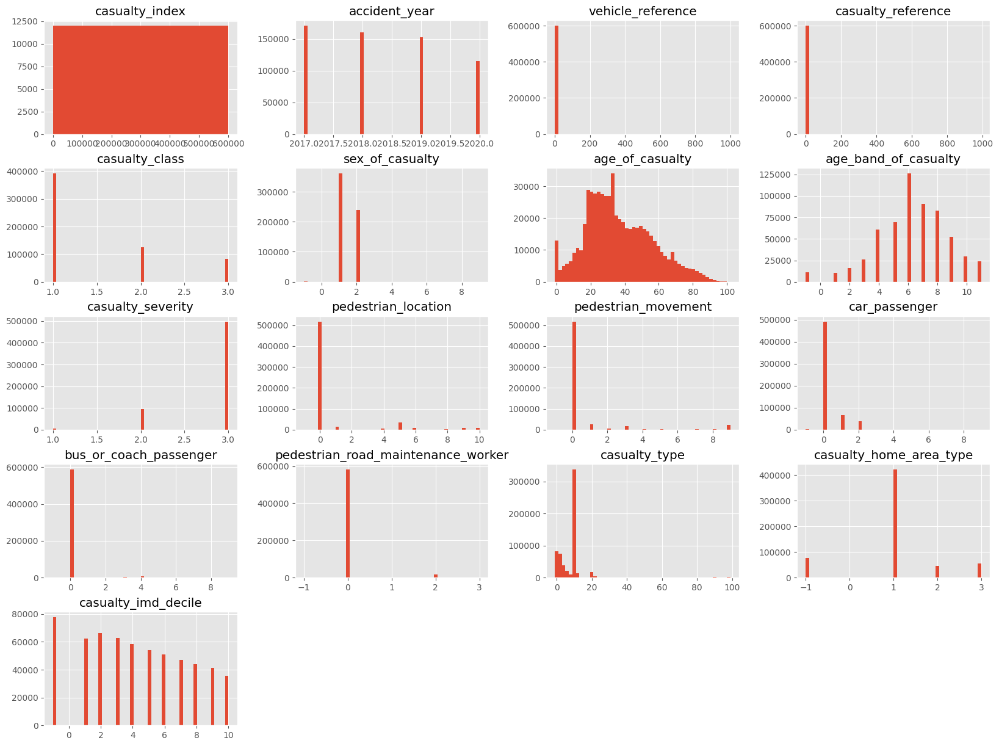

In [35]:
casualities.hist(bins = 50, figsize = (20,15))
plt.show()

In [36]:
print("Number of rows present in a dataset after preprocessing     :{}".format(casualities.shape[0]))
print("Number of columns present in a dataset after preprocessing  :{}".format(casualities.shape[1]))

Number of rows present in a dataset after preprocessing     :600332
Number of columns present in a dataset after preprocessing  :19


It's same because there isn't any null value and duplicates found.

In [37]:
casualities.head()

,casualty_index,accident_index,accident_year,accident_reference,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile
0,0,2017010001708,2017,010001708,1,1,2,2,18,4,3,0,0,1,0,0,9,1,2
1,1,2017010001708,2017,010001708,2,2,1,1,19,4,2,0,0,0,0,0,2,-1,-1
2,2,2017010001708,2017,010001708,2,3,2,1,18,4,1,0,0,0,0,0,2,-1,-1
3,3,2017010009342,2017,010009342,1,1,2,2,33,6,3,0,0,1,0,0,9,1,5
4,4,2017010009344,2017,010009344,3,1,1,2,31,6,3,0,0,0,0,0,9,1,5


In [38]:
casualities['accident_index'] = casualities['accident_index'].astype(str)
casualities['accident_reference'] = casualities['accident_reference'].astype(str)

In [39]:
# Calculate correlation for numeric columns only
numeric_columns = casualities.select_dtypes(include='number')
numeric_columns.corr()

,casualty_index,accident_year,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile
casualty_index,1.000000,0.965380,0.001136,0.000765,-0.036083,-0.021048,0.015794,0.012685,-0.041945,-0.020339,-0.019355,-0.016426,-0.040371,-0.147835,0.017891,0.125740,0.100566
accident_year,0.965380,1.000000,-0.004635,-0.005439,-0.023964,-0.034648,0.000618,-0.000892,-0.029624,-0.007733,-0.005474,-0.019622,-0.027743,-0.102369,0.001816,0.096441,0.068859
vehicle_reference,0.001136,-0.004635,1.000000,0.022760,-0.080301,0.004640,0.010628,0.013652,0.022671,-0.078260,-0.070333,0.009530,-0.010889,-0.039835,0.023350,0.002539,0.009617
casualty_reference,0.000765,-0.005439,0.022760,1.000000,0.047107,0.022019,-0.033921,-0.041214,0.017458,-0.038488,-0.031509,0.129692,0.067065,-0.018439,0.039542,-0.005406,-0.009397
casualty_class,-0.036083,-0.023964,-0.080301,0.047107,1.000000,0.142425,-0.110746,-0.162471,-0.065271,0.737999,0.645057,0.278781,0.095660,0.352278,-0.229709,-0.093960,-0.110572
sex_of_casualty,-0.021048,-0.034648,0.004640,0.022019,0.142425,1.000000,0.056446,0.055368,0.080028,0.021690,0.023955,0.128167,0.076542,0.020603,0.019880,0.032907,0.035860
age_of_casualty,0.015794,0.000618,0.010628,-0.033921,-0.110746,0.056446,1.000000,0.965869,-0.085661,-0.021519,-0.007836,-0.185331,0.040085,-0.013251,0.038189,0.088245,0.131142
age_band_of_casualty,0.012685,-0.000892,0.013652,-0.041214,-0.162471,0.055368,0.965869,1.000000,-0.078829,-0.047753,-0.029000,-0.223315,0.017127,-0.018736,0.043607,0.095498,0.130558
casualty_severity,-0.041945,-0.029624,0.022671,0.017458,-0.065271,0.080028,-0.085661,-0.078829,1.000000,-0.095406,-0.074828,0.061747,0.031411,-0.025068,0.059392,-0.017720,-0.011249
pedestrian_location,-0.020339,-0.007733,-0.078260,-0.038488,0.737999,0.021690,-0.021519,-0.047753,-0.095406,1.000000,0.830651,-0.138847,-0.047652,0.365312,-0.300546,-0.053265,-0.060783


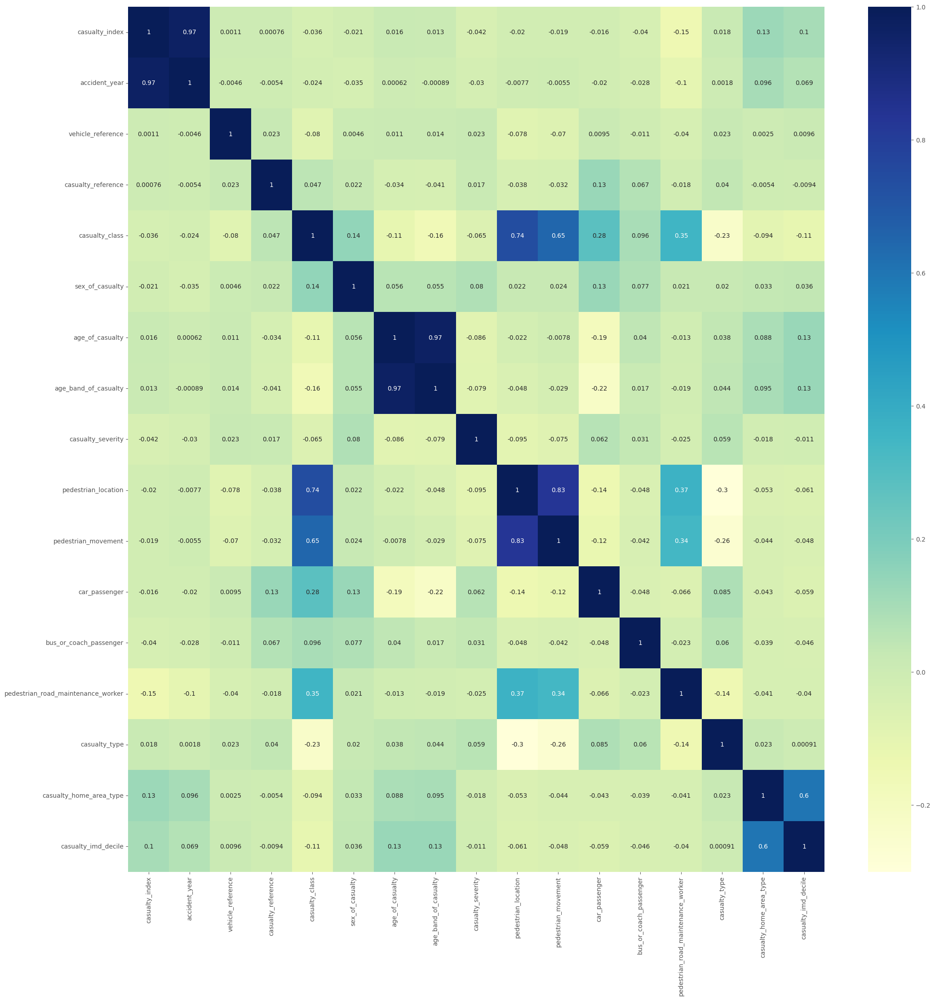

In [40]:
plt.figure(figsize = (25,25))
sns_plot = sns.heatmap(data = numeric_columns.corr(),annot = True, cmap = "YlGnBu")
sns_plot.figure.savefig("casuality.png")
plt.show()

#### Observation:

**Medium to Strong positive Correlation**

* **Casualty Class and Pedestrian Location (0.737999):** There is a strong positive correlation between the casualty class (e.g., driver, pedestrian, passenger) and the pedestrian location, indicating that pedestrian casualties are more likely to occur in accidents involving pedestrians.

* **Casualty Class and Pedestrian Movement (0.645057):** Similar to the previous point, casualty class is strongly positively correlated with pedestrian movement, suggesting that pedestrian casualties are more likely to involve certain types of movements.

* **Age of Casualty and Age Band of Casualty (0.965869):** The age of the casualty is highly positively correlated with the age band of the casualty, which is expected as the age band is derived from the age.

* **Casualty Home Area Type and Casualty IMD Decile (0.599741):** These two variables are moderately positively correlated with each other. It indicates that certain types of areas (e.g., urban, rural) may have higher IMD decile values, which are used to measure deprivation levels.

**Negative Correlation**:

* **Casualty Severity and Casualty Index (-0.041945):** There is a weak negative correlation between casualty severity and the casualty index. This implies that accidents with higher casualty indexes (more casualties) tend to have slightly lower casualty severity.

* **Casualty Class and Casualty Severity (-0.162471):** Casualty class is weakly negatively correlated with casualty severity, suggesting that certain casualty classes may have slightly lower severity.

* **Casualty Class and Pedestrian Road Maintenance Worker (-0.147835):** Casualty class is weakly negatively correlated with accidents involving pedestrian road maintenance workers. This indicates that such accidents are less likely to involve certain casualty classes.

* **Casualty Home Area Type and Accident Year (-0.102369):** Casualty home area type is weakly negatively correlated with the accident year, indicating that the type of home area (e.g., urban, rural) may be somewhat less affected by the passage of time.

Weak correlations may still carry valuable insights, but they are not as strong or significant as moderate or strong correlations. These correlation values give us a glimpse of the relationships between variables, but further statistical analysis or domain expertise may be required for a comprehensive understanding.

In summary, the casualty data shows that casualty-related variables (e.g., casualty class, type, severity, and characteristics like age and sex) are correlated with each other. Some variables are also related to the year of the accident and certain socio-economic characteristics of the casualty's home area. Understanding these correlations can help identify patterns and potential risk factors associated with road accidents and casualties.

## Vehicles

In [41]:
vehicles.head()

,vehicle_index,accident_index,accident_year,accident_reference,vehicle_reference,vehicle_type,towing_and_articulation,vehicle_manoeuvre,vehicle_direction_from,vehicle_direction_to,vehicle_location_restricted_lane,junction_location,skidding_and_overturning,hit_object_in_carriageway,vehicle_leaving_carriageway,hit_object_off_carriageway,first_point_of_impact,vehicle_left_hand_drive,journey_purpose_of_driver,sex_of_driver,age_of_driver,age_band_of_driver,engine_capacity_cc,propulsion_code,age_of_vehicle,generic_make_model,driver_imd_decile,driver_home_area_type
0,0,2017010001708,2017,010001708,1,9,0,18,1,5,0,0,0,0,0,0,1,1,6,1,24,5,1997,2,1,-1,-1,-1
1,1,2017010001708,2017,010001708,2,2,0,18,1,5,0,0,1,0,0,0,2,1,6,1,19,4,-1,-1,-1,-1,-1,-1
2,2,2017010009342,2017,010009342,1,9,0,18,5,1,0,1,0,0,0,0,2,1,6,1,33,6,1797,8,8,-1,9,1
3,3,2017010009342,2017,010009342,2,9,0,18,5,1,0,1,1,0,0,0,1,1,6,1,40,7,2204,2,12,-1,2,1
4,4,2017010009344,2017,010009344,1,9,0,18,3,7,0,1,0,0,0,0,1,1,6,3,-1,-1,-1,-1,-1,-1,-1,-1


In [42]:
print("Number of rows present in a dataset    :{}".format(vehicles.shape[0]))
print("Number of columns present in a dataset :{}".format(vehicles.shape[1]))

Number of rows present in a dataset    :849091
Number of columns present in a dataset :28


In [43]:
#name of columns
list(vehicles.columns)


['vehicle_index',
 'accident_index',
 'accident_year',
 'accident_reference',
 'vehicle_reference',
 'vehicle_type',
 'towing_and_articulation',
 'vehicle_manoeuvre',
 'vehicle_direction_from',
 'vehicle_direction_to',
 'vehicle_location_restricted_lane',
 'junction_location',
 'skidding_and_overturning',
 'hit_object_in_carriageway',
 'vehicle_leaving_carriageway',
 'hit_object_off_carriageway',
 'first_point_of_impact',
 'vehicle_left_hand_drive',
 'journey_purpose_of_driver',
 'sex_of_driver',
 'age_of_driver',
 'age_band_of_driver',
 'engine_capacity_cc',
 'propulsion_code',
 'age_of_vehicle',
 'generic_make_model',
 'driver_imd_decile',
 'driver_home_area_type']

In [44]:
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 849091 entries, 0 to 849090
Data columns (total 28 columns):
 #   Column                            Non-Null Count   Dtype 
---  ------                            --------------   ----- 
 0   vehicle_index                     849091 non-null  int64 
 1   accident_index                    849091 non-null  object
 2   accident_year                     849091 non-null  int64 
 3   accident_reference                849091 non-null  object
 4   vehicle_reference                 849091 non-null  int64 
 5   vehicle_type                      849091 non-null  int64 
 6   towing_and_articulation           849091 non-null  int64 
 7   vehicle_manoeuvre                 849091 non-null  int64 
 8   vehicle_direction_from            849091 non-null  int64 
 9   vehicle_direction_to              849091 non-null  int64 
 10  vehicle_location_restricted_lane  849091 non-null  int64 
 11  junction_location                 849091 non-null  int64 
 12  sk

In [45]:
#check if there are null values in the data
vehicles.isnull().sum()

vehicle_index                       0
accident_index                      0
accident_year                       0
accident_reference                  0
vehicle_reference                   0
vehicle_type                        0
towing_and_articulation             0
vehicle_manoeuvre                   0
vehicle_direction_from              0
vehicle_direction_to                0
vehicle_location_restricted_lane    0
junction_location                   0
skidding_and_overturning            0
hit_object_in_carriageway           0
vehicle_leaving_carriageway         0
hit_object_off_carriageway          0
first_point_of_impact               0
vehicle_left_hand_drive             0
journey_purpose_of_driver           0
sex_of_driver                       0
age_of_driver                       0
age_band_of_driver                  0
engine_capacity_cc                  0
propulsion_code                     0
age_of_vehicle                      0
generic_make_model                  0
driver_imd_d

* There isn't any null values in this table.

In [46]:
vehicles.duplicated().sum()

0

* There isn't any duplicate value

In [47]:
vehicles.describe().T


,count,mean,std,min,25%,50%,75%,max
vehicle_index,849091.0,424545.000000,245111.603045,0.0,212272.5,424545.0,636817.5,849090.0
accident_year,849091.0,2018.367693,1.090652,2017.0,2017.0,2018.0,2019.0,2020.0
vehicle_reference,849091.0,1.560201,1.705475,1.0,1.0,1.0,2.0,999.0
vehicle_type,849091.0,9.919154,10.731438,-1.0,9.0,9.0,9.0,99.0
towing_and_articulation,849091.0,0.186483,1.221928,-1.0,0.0,0.0,0.0,9.0
vehicle_manoeuvre,849091.0,16.745490,19.089002,-1.0,7.0,18.0,18.0,99.0
vehicle_direction_from,849091.0,4.300950,2.629313,-1.0,2.0,4.0,7.0,9.0
vehicle_direction_to,849091.0,4.339601,2.619161,-1.0,2.0,4.0,7.0,9.0
vehicle_location_restricted_lane,849091.0,4.616092,20.465322,-1.0,0.0,0.0,0.0,99.0
junction_location,849091.0,2.482244,3.194240,-1.0,0.0,1.0,5.0,9.0


* **Accident Year:** The data spans from the year 2017 to 2020. Most accidents occurred in the years 2018 and 2019, as the median (50th percentile) is 2018.

* **Vehicle Reference:** The "vehicle_reference" column indicates a type or category of the vehicle involved in the accidents. The values range from 1 to 999. However, without additional information about the vehicle types corresponding to these references, it's challenging to draw specific conclusions.

* **Vehicle Type:** The "vehicle_type" column represents the type of vehicles involved in the accidents. The values range from -1 to 99, and the median is 9. This indicates that there might be a variety of vehicle types, possibly represented by numeric codes.

* **Vehicle Age:** The "age_of_vehicle" column indicates the age of the vehicles involved in the accidents. The values range from 0 to 96 years. Most vehicles involved in accidents seem to be relatively new, as the median age is 5 years.

* **Driver IMD Decile:** The "driver_imd_decile" column indicates the decile of the driver's Index of Multiple Deprivation (IMD). IMD is a measure of the socio-economic deprivation of an area in the UK. The values range from -1 to 10, with negative values potentially indicating missing or unknown data.



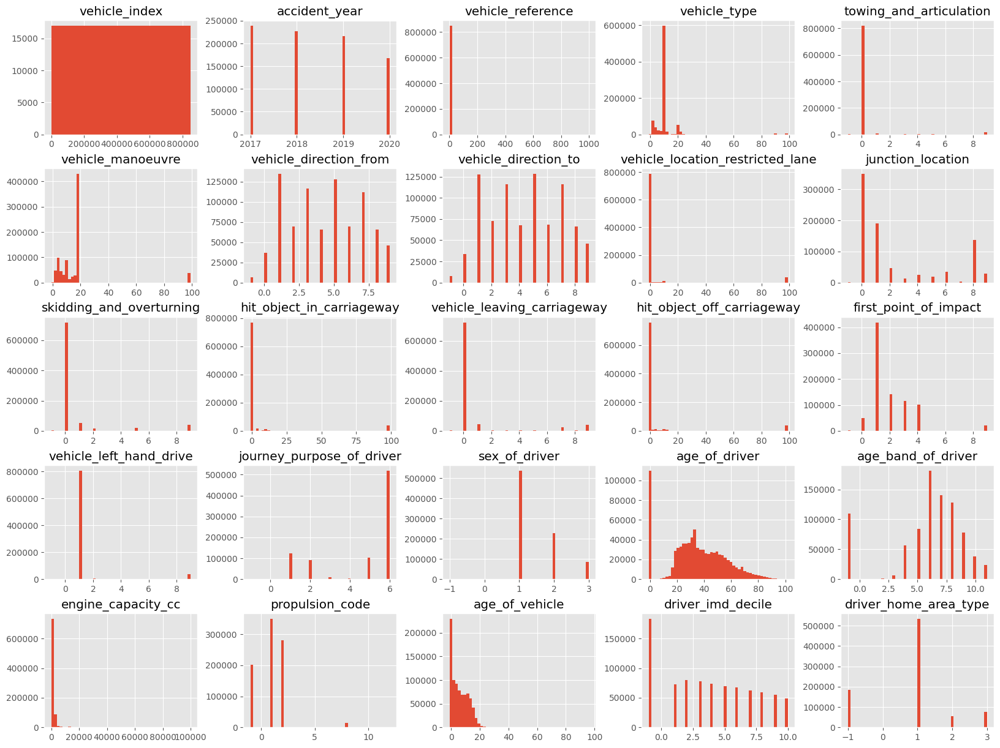

In [48]:
vehicles.hist(bins = 50, figsize = (20,15))
plt.show()

In [49]:
print("Number of rows present in a dataset after preprocessing     :{}".format(vehicles.shape[0]))
print("Number of columns present in a dataset after preprocessing  :{}".format(vehicles.shape[1]))

Number of rows present in a dataset after preprocessing     :849091
Number of columns present in a dataset after preprocessing  :28


In [50]:
# Calculate correlation for numeric columns only
numeric_columns = vehicles.select_dtypes(include='number')
numeric_columns.corr()

,vehicle_index,accident_year,vehicle_reference,vehicle_type,towing_and_articulation,vehicle_manoeuvre,vehicle_direction_from,vehicle_direction_to,vehicle_location_restricted_lane,junction_location,skidding_and_overturning,hit_object_in_carriageway,vehicle_leaving_carriageway,hit_object_off_carriageway,first_point_of_impact,vehicle_left_hand_drive,journey_purpose_of_driver,sex_of_driver,age_of_driver,age_band_of_driver,engine_capacity_cc,propulsion_code,age_of_vehicle,driver_imd_decile,driver_home_area_type
vehicle_index,1.000000,0.965823,-0.000183,0.006089,-0.032340,0.035713,0.004820,0.005694,0.028985,-0.012814,0.025601,0.021460,0.032678,0.034214,-0.006139,-0.015494,0.007613,0.011748,0.012707,0.008467,-0.024704,-0.016527,0.010242,0.086140,0.103236
accident_year,0.965823,1.000000,-0.002960,0.000490,0.011618,0.102930,0.030195,0.032744,0.102537,0.022140,0.093038,0.097078,0.084778,0.106125,0.028076,0.055244,0.006929,0.025628,-0.018510,-0.023325,-0.028598,-0.008500,-0.002253,0.049532,0.067791
vehicle_reference,-0.000183,-0.002960,1.000000,-0.002905,-0.015272,-0.026945,-0.034106,-0.043483,-0.013355,-0.025649,-0.025872,-0.015666,-0.035196,-0.017051,0.001045,0.001892,0.010399,0.037991,-0.021191,-0.028762,-0.001536,-0.008161,-0.024647,-0.008345,-0.018369
vehicle_type,0.006089,0.000490,-0.002905,1.000000,-0.000991,-0.027319,-0.017268,-0.019864,-0.016174,-0.049526,-0.027077,-0.017400,-0.013937,-0.016713,-0.014140,0.031319,-0.101459,0.047308,-0.033509,-0.056458,0.121632,-0.004459,-0.048382,-0.081479,-0.079096
towing_and_articulation,-0.032340,0.011618,-0.015272,-0.000991,1.000000,0.404484,0.194367,0.195619,0.446090,0.132459,0.462986,0.467203,0.366927,0.440693,0.331562,0.274859,0.000462,0.042408,-0.077624,-0.089244,-0.012491,-0.073417,-0.079009,-0.047829,-0.054565
vehicle_manoeuvre,0.035713,0.102930,-0.026945,-0.027319,0.404484,1.000000,0.407690,0.406154,0.875023,0.259327,0.806364,0.875260,0.733659,0.872701,0.359826,0.686661,0.079796,0.115657,-0.129059,-0.142879,-0.066841,-0.045203,-0.061115,-0.055582,-0.061049
vehicle_direction_from,0.004820,0.030195,-0.034106,-0.017268,0.194367,0.407690,1.000000,0.022535,0.371624,0.157545,0.351221,0.379836,0.319037,0.374447,0.167563,0.318040,0.012250,-0.010366,-0.004484,0.002750,-0.025946,-0.011646,-0.024049,0.018694,0.021239
vehicle_direction_to,0.005694,0.032744,-0.043483,-0.019864,0.195619,0.406154,0.022535,1.000000,0.372343,0.160569,0.351700,0.380161,0.316582,0.373972,0.166313,0.319006,0.017279,-0.006688,-0.004265,0.002209,-0.027179,-0.010424,-0.022098,0.016154,0.018464
vehicle_location_restricted_lane,0.028985,0.102537,-0.013355,-0.016174,0.446090,0.875023,0.371624,0.372343,1.000000,0.276269,0.863741,0.947372,0.783122,0.951004,0.393295,0.713355,0.081491,0.158235,-0.146001,-0.168274,-0.051696,-0.021633,-0.057734,-0.074982,-0.088466
junction_location,-0.012814,0.022140,-0.025649,-0.049526,0.132459,0.259327,0.157545,0.160569,0.276269,1.000000,0.231127,0.273675,0.201206,0.267804,0.165902,0.211713,0.032642,0.023720,-0.016298,-0.017203,-0.060931,-0.026312,-0.034276,-0.006252,-0.022181


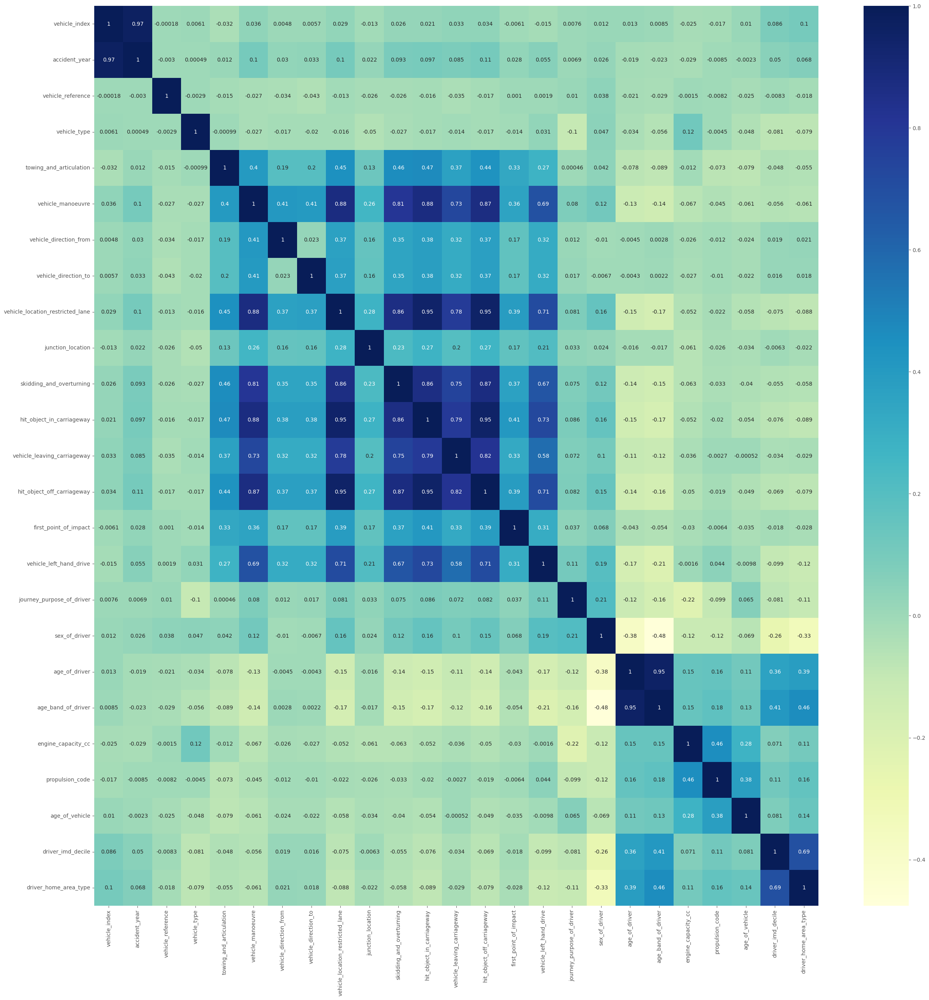

In [51]:
plt.figure(figsize = (30,30))
sns_plot = sns.heatmap(data = numeric_columns.corr(),annot = True, cmap = "YlGnBu")
sns_plot.figure.savefig("vehicles.png")
plt.show()

#### Obervation


* **Accident Year and Vehicle Index:** There is a strong positive correlation (0.97) between the "accident_year" and "vehicle_index" columns, indicating that accidents tend to be indexed chronologically.

* **Vehicle Manoeuvre and Skidding/Overturning:** The "vehicle_manoeuvre" and "skidding_and_overturning" columns are positively correlated (0.46), suggesting that certain types of vehicle maneuvers may be associated with skidding or overturning incidents.

* **Age of Driver and Propulsion Code:** The "age_of_driver" and "propulsion_code" columns show a weak negative correlation (-0.08), indicating that older drivers may have slightly different types of propulsion systems in their vehicles.

* **Age of Vehicle and Journey Purpose of Driver:** There is a weak positive correlation (0.07) between the "age_of_vehicle" and "journey_purpose_of_driver" columns, suggesting that the age of the vehicle might influence the purpose of the driver's journey.

* **Engine Capacity and Age of Driver:** The "engine_capacity_cc" and "age_of_driver" columns have a weak positive correlation (0.15), indicating that vehicles with higher engine capacities might be driven by slightly older drivers.

* **Driver IMD Decile and Driver Home Area Type:** The "driver_imd_decile" and "driver_home_area_type" columns show a positive correlation (0.69), suggesting that drivers living in certain area types might have specific levels of socio-economic deprivation.

## Analysis

### Quantity and Severity of the accidents



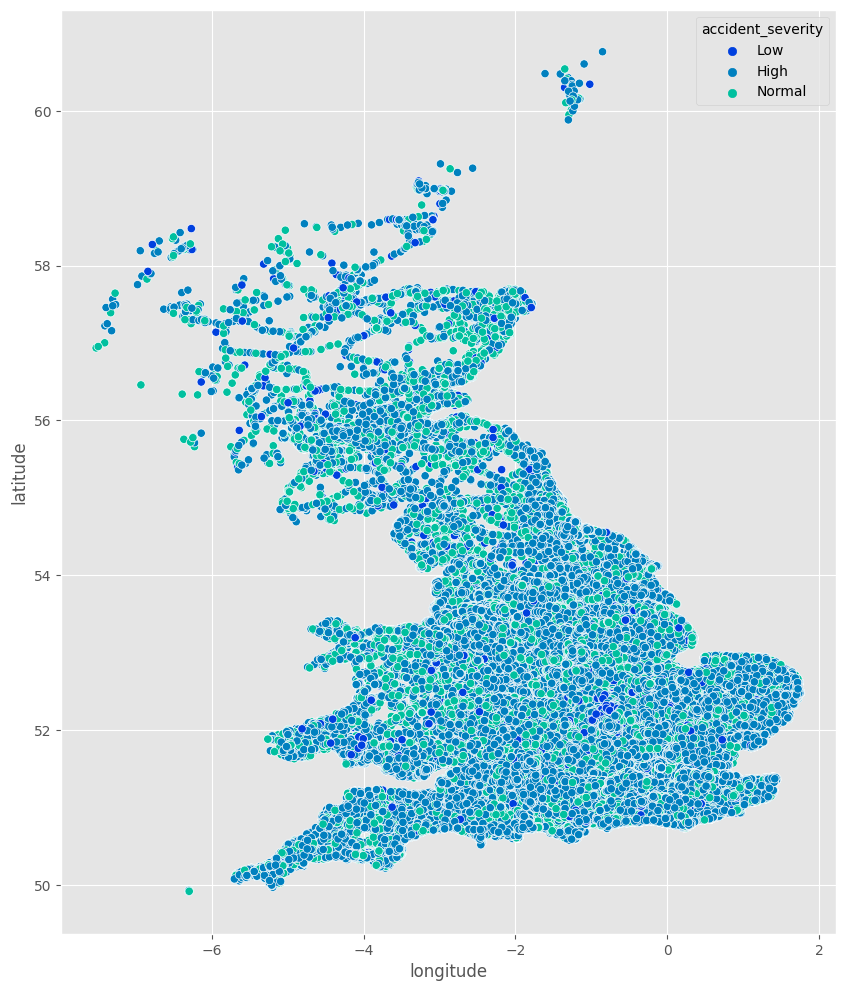

In [52]:
plt.figure(figsize = (10,12))
sns_plot = sns.scatterplot(data=accidents, x = "longitude", y = "latitude", hue = "accident_severity", palette = "winter")
sns_plot.figure.savefig("quantity_severity.png")
plt.show()

In [53]:
fig = px.histogram(accidents, x = 'accident_severity')
fig.update_xaxes(categoryorder = 'total ascending')
fig.update_layout( title="Accidents Severity") 
fig.show()

* Majority of the Accidents have high severity.

**CODES**
1. Roundabout
2. One way street
3. Dual carriageway
6. Single carriageway
7. Slip Road
9. Unknow

In [54]:
temp = accidents["road_type"].value_counts()
temp.index = ['Single carriageway','Dual_carriageway','Roundabout',
                    'One_way_street ',
                    'Unknown','Slip road']

In [55]:
temp

Single carriageway    334294
Dual_carriageway       71594
Roundabout             28439
One_way_street         11381
Unknown                 9086
Slip road               6432
Name: count, dtype: int64

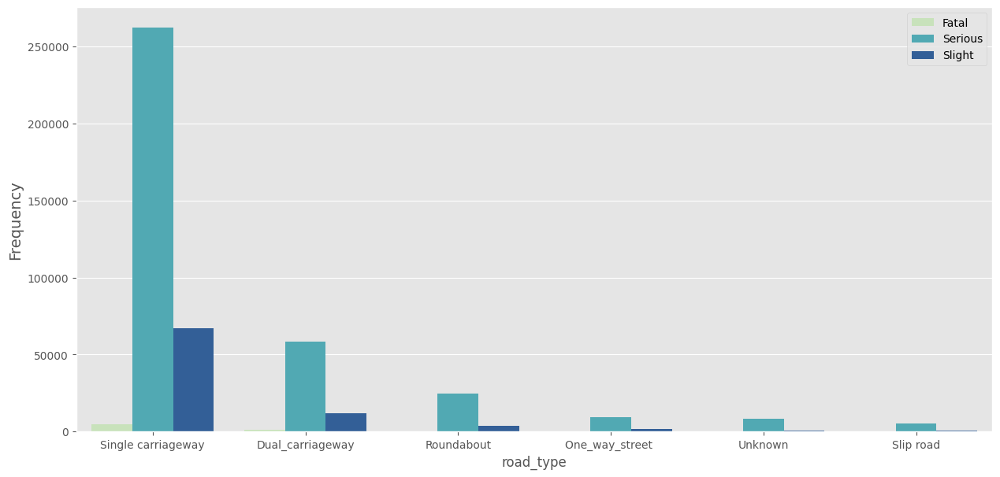

In [56]:
plt.figure(figsize=(15,7))
ax = sns.countplot('road_type',hue='accident_severity',data=accidents, 
                   order = accidents["road_type"].value_counts().index, palette = "YlGnBu")
ax.set_xticklabels(['Single carriageway','Dual_carriageway','Roundabout',
                    'One_way_street ',
                    'Unknown','Slip road'])
plt.legend(['Fatal','Serious','Slight'])
plt.ylabel("Frequency", fontsize = 14)
plt.show()

1. Single Carriageway: Single carriageways have the highest number of accidents with 334,294 recorded cases. Single carriageways typically have a single lane of traffic in each direction, and the higher number of accidents might be due to the increased presence of these roads or other factors specific to this road type.

2. Dual Carriageway: Dual carriageways have 71,594 recorded accidents. Dual carriageways are high-speed roads with separated traffic flows. Although the number of accidents is lower than single carriageways, it is still significant, possibly due to the higher speed and traffic volume on these roads.

3. Roundabout: Roundabouts have 28,439 recorded accidents. Roundabouts can be complex traffic intersections, and the accidents recorded here might be attributed to the intricacies of navigating them.

4. One Way Street: One-way streets have 11,381 recorded accidents. This is notably lower than single and dual carriageways, possibly due to the directionality of traffic flow and other road design factors.

5. Unknown: There are 9,086 accidents with an unknown road type or not specified. This information might be missing or incomplete in the dataset, which could limit drawing concrete conclusions about these accidents.

6. Slip Road: Slip roads have 6,432 recorded accidents. Slip roads are short connecting roads that allow vehicles to enter or exit highways, and the accidents here might be attributed to merging or lane-changing maneuvers.

Overall, the data suggests that single carriageways have the highest number of accidents, followed by dual carriageways. Roundabouts and one-way streets have a lower number of accidents compared to the main carriageway types. It's important to consider additional factors such as traffic volume, road design, and driving behavior to gain deeper insights into the accident patterns on each road type and develop appropriate safety measures. 

#### what are the Areas where more accidents occurs?

In [57]:
m_1 = folium.Map(locations = [51.500153, -0.1262362],
                 tiles = 'cartodbpositron', zoom_start=40)
HeatMap(data = accidents[['latitude','longitude']],radius = 10).add_to(m_1)
m_1

As we could have imagined, the areas in which the most accidents have occurred are the most trafficked and in which the largest cities are located, mainly the neighboring areas in London

#### Are road safety campaigns effective?

In [58]:
accidents['accident_year'] = accidents['accident_year'].astype(str)

In [59]:
fig = px.histogram(accidents, x = 'accident_year')
fig.update_xaxes(categoryorder = 'total ascending')
fig.update_layout( title="Accidents per Year") 
fig.show()

As we can see the number of accidents are decreasing so we can say that the safety campaign is so effective so far

#### 1.  Are there significant hours of the day, and days of the week, on which accidents occur?


In [60]:
accidents['hour'].value_counts()

hour
17    40299
16    37159
15    36133
18    33204
8     31147
14    28536
13    27456
12    26497
19    24645
11    23350
9     21512
10    20714
7     20597
20    18028
21    14450
22    12669
23     9632
6      9356
0      6879
1      4858
5      4473
2      3685
3      3114
4      2833
Name: count, dtype: int64

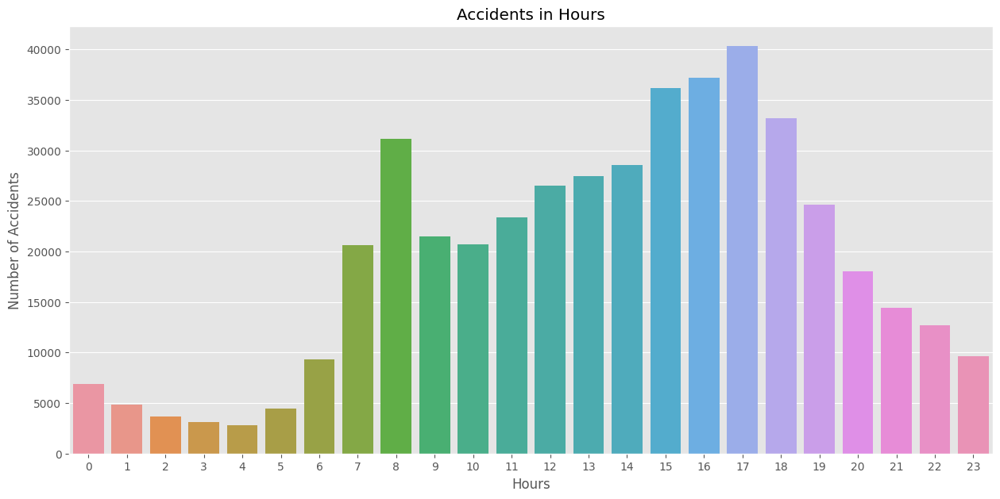

In [61]:
plt.figure(figsize = (15, 7))
sns.countplot(x='hour', data=accidents)
plt.title('Accidents in Hours')
plt.xlabel('Hours')
plt.ylabel('Number of Accidents')
plt.show()

The output shows the number of accidents that occurred during different hours of the day throughout the year. Let's analyze it:

* **Peak Accident Hours:** The hours with the highest number of accidents are 17:00 (5:00 PM) with 40,299 accidents, followed closely by 16:00 (4:00 PM) with 37,159 accidents, and 15:00 (3:00 PM) with 36,133 accidents. These hours seem to be critical periods for accidents, possibly due to higher traffic volume and rush hours.



* **Evening Hours:** The hours between 18:00 (6:00 PM) and 20:00 (8:00 PM) also have significant accident counts, with 33,204, 31,147, and 28,536 accidents, respectively. These hours might experience increased traffic as people head home after work.


* **Morning Rush Hours:** The morning hours between 08:00 (8:00 AM) and 11:00 (11:00 AM) show a notable number of accidents, with 26,497, 24,645, 23,350, and 21,512 accidents, respectively. These hours likely correspond to the morning rush when people are commuting to work or other activities.


* **Late Night Hours:** The hours between 00:00 (12:00 AM) and 06:00 (6:00 AM) generally have lower accident counts, with 9,632 being the highest at 23:00 (11:00 PM) and 6,879 at midnight (12:00 AM). These hours might have fewer vehicles on the road, contributing to the lower number of accidents.


* **Accidents at Early Morning:** It's interesting to note that even though the early morning hours have fewer accidents, they are not entirely accident-free. Hours between 05:00 (5:00 AM) and 09:00 (9:00 AM) still have a considerable number of accidents, ranging from 4,473 to 26,497.



In [62]:
accidents['weekday'].value_counts()

weekday
Friday       75184
Thursday     70467
Wednesday    69040
Tuesday      68276
Monday       65073
Saturday     61170
Sunday       52016
Name: count, dtype: int64

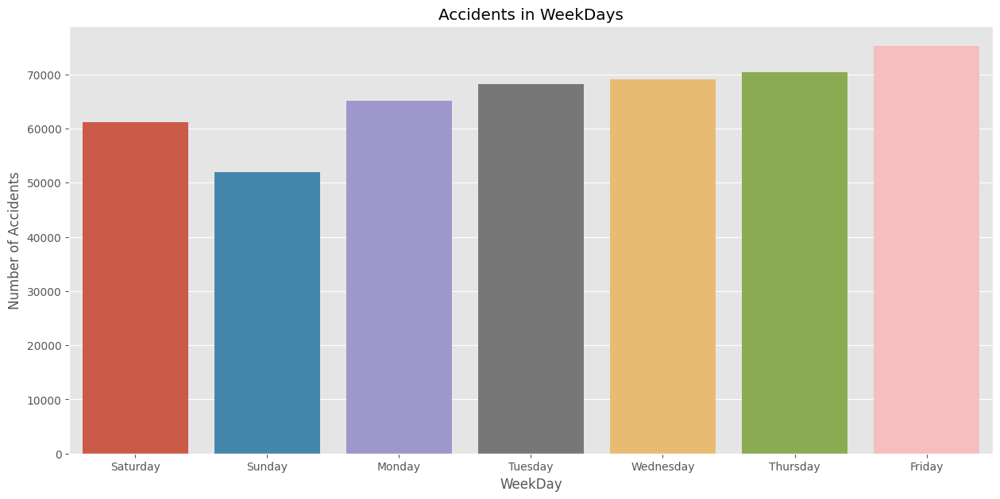

In [63]:
plt.figure(figsize = (15, 7))
sns.countplot(x='weekday', data=accidents)
plt.title('Accidents in WeekDays')
plt.xlabel('WeekDay')
plt.ylabel('Number of Accidents')
plt.show()

#### Observation

**Insights:**
The data indicates that weekdays generally have higher accident counts compared to weekends. This is likely due to increased traffic and commuting activities during the workweek. Fridays, Thursdays, and Wednesdays consistently have higher accident numbers, suggesting that mid-to-late workweek periods might experience higher risk factors for road incidents.

**Practical Applications:** 

Authorities and road safety organizations can use this information to target specific days for road safety campaigns, traffic management, and law enforcement. For instance, they can focus on promoting safe driving habits, conducting alcohol and speed checks, and improving road conditions on weekdays to reduce accident rates during these busy periods. Similarly, measures can be taken to ensure road safety during weekends when people might be more relaxed but still need to be cautious while driving.

#### For motorbikes, are there significant hours of the day, and days of the week, on which accidents occur? We suggest a focus on: Motorcycle 125cc and under, Motorcycle over 125cc and up to 500cc, and Motorcycle over 500cc.

Here are the codes from file for vehicle type

02. Motorcycle 50cc and under
03. Motorcycle over 50cc and up to 125cc
04. Motorcycle over 125cc and up to 500cc
05. Motorcycle over 500cc 

we'll use 3, 4 and 5 code

In [64]:
merge_data = accidents[['accident_index', 'weekday', 'hour']]
merge_data = pd.merge(vehicles, merge_data, on = 'accident_index', how = 'left')

In [65]:
# Filter the data for motorbike accidents
motorbike_data = merge_data[merge_data['vehicle_type'].isin([3, 4, 5])]

In [66]:
motorbike_data['hour'] = motorbike_data['hour'].astype('Int64').astype(str)

In [67]:
motorbike_data.groupby(['hour', 'vehicle_type'])['vehicle_type'].count().rename('accidents').reset_index()

,hour,vehicle_type,accidents
0,0,3,405
1,0,4,86
2,0,5,108
3,1,3,272
4,1,4,59
...,...,...,...
69,9,3,1060
70,9,4,316
71,9,5,813
72,<NA>,3,9


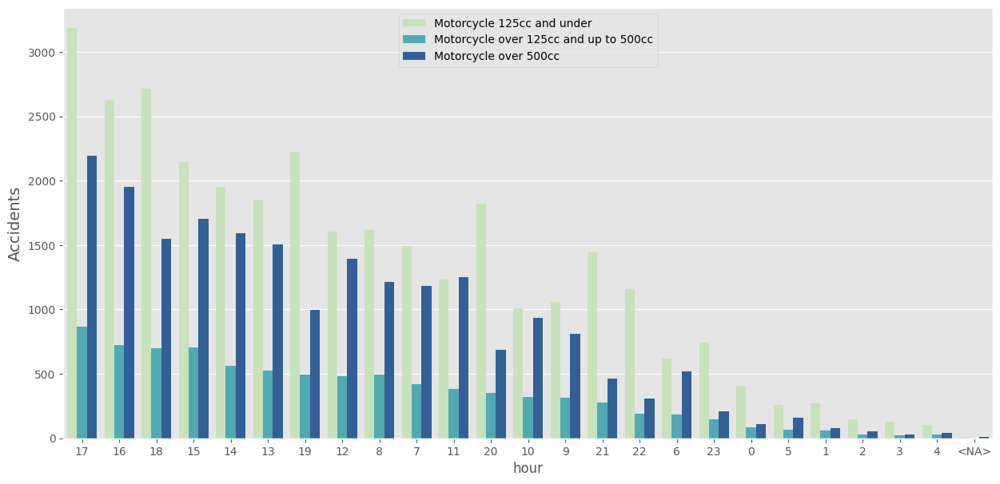

In [68]:
plt.figure(figsize=(15,7))
ax = sns.countplot('hour',hue='vehicle_type',data=motorbike_data, 
                   order = motorbike_data["hour"].value_counts().index, palette = "YlGnBu")
plt.legend(['Motorcycle 125cc and under','Motorcycle over 125cc and up to 500cc','Motorcycle over 500cc '])
plt.ylabel("Accidents", fontsize = 14)
plt.show()

Observations for each motorbike type regarding significant hours of the day and days of the week when accidents occur:

* **Motorcycle 125cc and under:**

    * Significant Hours of the Day: Accidents are relatively low during the early morning hours (from 0:00 to 5:00). The number of accidents starts to increase from 6:00 and reaches a peak during late afternoon to early evening (from 15:00 to 18:00), with the highest number of accidents occurring at 17:00 (3183 accidents).

* **Motorcycle over 125cc and up to 500cc:**

    * Significant Hours of the Day: Similar to the smaller motorbikes, accidents are less common during the early morning hours. The number of accidents starts to increase from 6:00 and peaks during late afternoon (from 15:00 to 17:00), with the highest number of accidents occurring at 17:00 (866 accidents).

* **Motorcycle over 500cc:**

    * Significant Hours of the Day: The trend is similar to the other motorbike types, with fewer accidents during early morning hours. Accidents start to rise from 6:00 and peak during late afternoon and early evening (from 15:00 to 18:00), with the highest number of accidents occurring at 17:00 (2196 accidents).
    
    
Overall, for all motorbike types, the hours of 15:00 to 18:00 (3:00 PM to 6:00 PM) seem to be critical, with the highest number of accidents occurring during this time frame. Additionally, weekdays have a higher frequency of accidents compared to weekends, indicating that more attention should be given to motorbike safety on weekdays

In [69]:
motorbike_data.groupby(['weekday', 'vehicle_type'])['vehicle_type'].count().rename('accidents').reset_index()

,weekday,vehicle_type,accidents
0,Friday,3,5385
1,Friday,4,1372
2,Friday,5,3159
3,Monday,3,4298
4,Monday,4,1151
5,Monday,5,2600
6,Saturday,3,4114
7,Saturday,4,1088
8,Saturday,5,3038
9,Sunday,3,3379


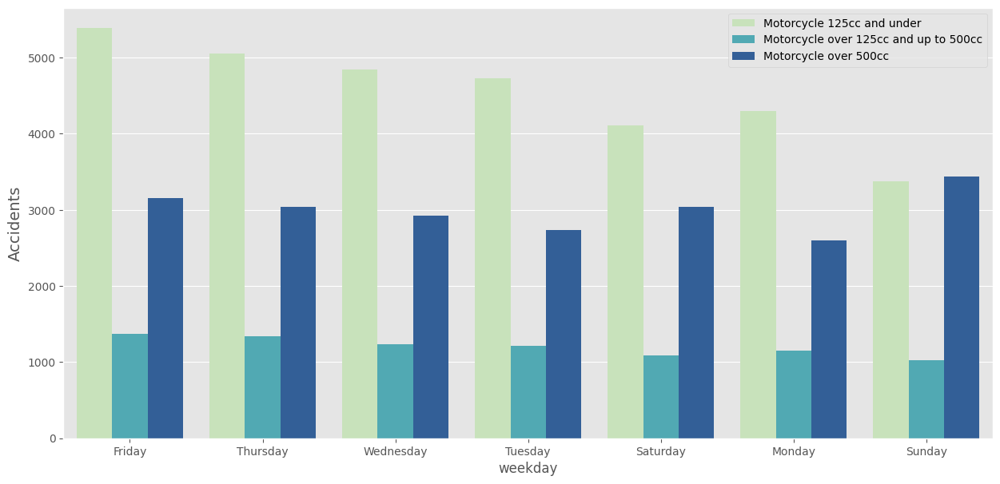

In [70]:
plt.figure(figsize=(15,7))
ax = sns.countplot('weekday',hue='vehicle_type',data=motorbike_data, 
                   order = motorbike_data["weekday"].value_counts().index, palette = "YlGnBu")
plt.legend(['Motorcycle 125cc and under','Motorcycle over 125cc and up to 500cc','Motorcycle over 500cc '])
plt.ylabel("Accidents", fontsize = 14)
plt.show()

* Majority of the accidents occured under 125 cc bikes
* On second it's under 500 cc bikes

Overall, for each motorbike type, the distribution of accidents across weekdays differs. For Motorcycle 125cc and under, Fridays have the most accidents, while for Motorcycle over 125cc and up to 500cc, Fridays have the highest number of accidents. However, for Motorcycle over 500cc, Sundays have the highest number of accidents. Mondays tend to have the fewest accidents for Motorcycle 125cc and under and Motorcycle over 125cc and up to 500cc, while Saturdays have the fewest accidents for Motorcycle over 500cc.

These observations suggest that different motorbike types may have varying patterns of accidents across weekdays, and it is important to consider these patterns when implementing safety measures and traffic regulations.

#### For pedestrians involved in accidents, are there significant hours of the day, and days of the week, on which they are more likely to be involved?

**CODES**
1. Driver or rider
2. Vehicle or pillion passenger
3. Pedestrian 

In [71]:
#first we need to filter the data based on casualities class

In [72]:
merge_data = accidents[['accident_index', 'weekday', 'hour']]
merge_data = pd.merge(casualities, merge_data, on = 'accident_index', how = 'left')

In [73]:
#get only pedestrians data
pedestrians = merge_data[merge_data['casualty_class'] == 3]

In [74]:
pedestrians['hour'].value_counts()

hour
15.0    9003
16.0    7351
17.0    7332
8.0     6448
18.0    6157
14.0    4838
13.0    4680
12.0    4566
19.0    4561
11.0    3921
10.0    3583
9.0     3556
20.0    3068
7.0     2680
21.0    2282
22.0    2092
23.0    1586
0.0     1253
6.0      913
1.0      862
2.0      643
3.0      549
5.0      428
4.0      391
Name: count, dtype: int64

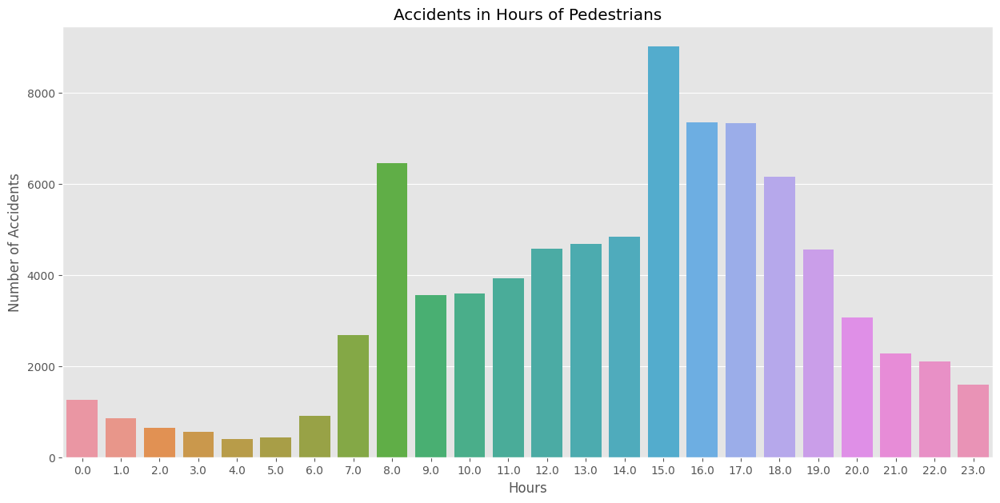

In [75]:
plt.figure(figsize = (15, 7))
sns.countplot(x='hour', data=pedestrians)
plt.title('Accidents in Hours of Pedestrians')
plt.xlabel('Hours')
plt.ylabel('Number of Accidents')
plt.show()

#### Observation 

* The peak hours for pedestrian accidents are in the late afternoon to early evening, specifically between 15:00 and 18:00. The highest number of accidents occurs at 15:00 (9003 accidents), followed closely by 16:00 (7351 accidents) and 17:00 (7332 accidents).

* There is a notable drop in the number of accidents during the early morning hours, between 2:00 and 6:00. The lowest number of accidents occurs at 4:00 (391 accidents) and 5:00 (428 accidents).

* The early morning hours between 7:00 and 10:00 also have a relatively lower number of accidents compared to the peak hours in the late afternoon.

* Accidents involving pedestrians gradually increase during the morning hours, with a peak around 9:00 (3556 accidents) and then decline again in the early afternoon.

Overall, the data shows a clear pattern of higher pedestrian accident rates during the late afternoon and early evening hours, while the early morning and late-night hours have lower accident rates. This pattern suggests that there might be specific factors or behaviors contributing to the increased risk for pedestrians during the peak hours. It highlights the need for pedestrian safety measures, such as improved visibility, traffic control at pedestrian crossings, and public awareness campaigns, to reduce the number of accidents during the high-risk hours.

In [76]:
pedestrians['weekday'].value_counts()

weekday
Friday       14166
Thursday     12983
Wednesday    12778
Tuesday      12636
Monday       11942
Saturday     10727
Sunday        7511
Name: count, dtype: int64

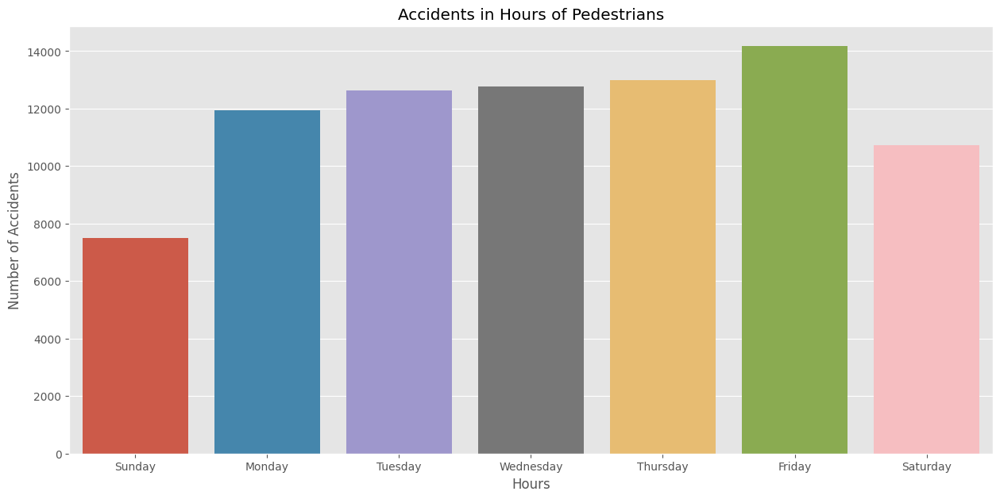

In [77]:
plt.figure(figsize = (15, 7))
sns.countplot(x='weekday', data=pedestrians)
plt.title('Accidents in Hours of Pedestrians')
plt.xlabel('Hours')
plt.ylabel('Number of Accidents')
plt.show()

#### Observations

* Fridays have the highest number of pedestrian accidents, with 14,166 accidents recorded.

* Thursdays and Wednesdays follow closely behind with 12,983 and 12,778 accidents, respectively.

* Tuesdays and Mondays have a similar number of accidents, with 12,636 and 11,942 accidents, respectively.

* Saturdays have a relatively lower number of pedestrian accidents compared to weekdays, with 10,727 accidents.

* Sundays have the lowest number of pedestrian accidents, with 7,511 accidents.

Overall, the data suggests that weekdays, especially Fridays, experience a higher number of pedestrian accidents compared to weekends. This might be attributed to increased weekday traffic, more pedestrians commuting to work or school, and other factors that could contribute to higher accident rates on weekdays. On the other hand, weekends, particularly Sundays, see a decline in pedestrian accidents, which might be due to reduced work-related traffic and fewer pedestrians on the roads. These observations emphasize the importance of implementing safety measures and raising awareness about pedestrian safety, especially during peak hours and busy weekdays, to reduce the number of accidents and ensure the well-being of pedestrians.







#### 4. Using the apriori algorithm, explore the impact of selected variables on accident severity.

The Apriori algorithm is designed to work with binary data, we cannot directly apply it to numeric data with multiple categories like accident severity (Low, Normal, and High).

Instead, we can use a different approach to explore the impact of selected variables on accident severity. We can use statistical tests like ANOVA (Analysis of Variance) or chi-square test to determine if there are significant differences in the selected variables across different levels of accident severity.

In [78]:
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

In [79]:
accidents = accidents.replace({'accident_severity': {'Low': 1, 'Normal': 2, 'High': 3}})

In [80]:
selected_data = accidents.select_dtypes(include=['number'])

In [81]:
selected_data = selected_data.apply(pd.to_numeric)


In [82]:
selected_columns = selected_data.drop(['accident_severity'],axis = 1).columns

In [83]:
import scipy.stats as stats
import numpy as np

In [84]:
# Assuming 'selected_data' is the DataFrame with the selected columns and mapped accident_severity
result = {}

for column in selected_columns:  # Excluded 'accident_severity' from the loop
    grouped_data = selected_data.groupby('accident_severity')[column].apply(list)
    anova_result = stats.f_oneway(*grouped_data)
    result[column] = {'F-statistic': anova_result.statistic, 'p-value': anova_result.pvalue}

anova_df = pd.DataFrame.from_dict(result, orient='index')
anova_df = anova_df.sort_values(by='p-value')
print(anova_df)

                                             F-statistic        p-value
junction_control                             1115.579604   0.000000e+00
speed_limit                                  2564.966879   0.000000e+00
urban_or_rural_area                          2424.593392   0.000000e+00
did_police_officer_attend_scene_of_accident  4351.867464   0.000000e+00
second_road_class                             816.929522   0.000000e+00
number_of_casualties                         1339.724255   0.000000e+00
local_authority_district                     1024.801141   0.000000e+00
police_force                                  977.267773   0.000000e+00
number_of_vehicles                           1281.840567   0.000000e+00
location_northing_osgr                        742.276268  1.432790e-322
latitude                                      740.682699  6.916919e-322
pedestrian_crossing_human_control             729.982603  2.973651e-317
light_conditions                              634.526553  6.4127

The results show the F-statistic and p-value for each selected variable in the ANOVA analysis to explore their impact on accident severity levels (Low, Normal, and High). The p-value measures the significance of the relationship between each variable and accident severity.

Lower p-values (close to 0) indicate a stronger relationship between the variable and accident severity. In contrast, higher p-values indicate weaker or no significant relationship.


1. **Variables with extremely low p-values (close to 0):**

    * junction_control
    * speed_limit
    * urban_or_rural_area
    * did_police_officer_attend_scene_of_accident
    * second_road_class
    * number_of_casualties
    * local_authority_district
    * police_force
    * number_of_vehicles
    
These variables have a highly significant impact on accident severity. They are likely to play a critical role in determining the severity of accidents.

2. **Variables with relatively low p-values:**

    * location_northing_osgr
    * latitude
    * pedestrian_crossing_human_control
    * light_conditions
    * trunk_road_flag
    * pedestrian_crossing_physical_facilities
    * longitude
    * junction_detail
    * location_easting_osgr
    * first_road_class
    * road_type
    * weather_conditions
    * special_conditions_at_site
    * carriageway_hazards
    * road_surface_conditions

These variables also have a significant impact on accident severity, although slightly less significant compared to the first group.


3. **Variables with higher p-values:**

    * first_road_number
    * second_road_number
    * hour
    * month
    * day
    * day_of_week
    
These variables show a relatively weaker relationship with accident severity. However, they still have some influence, and it is essential to consider them in the overall analysis.

**Conclusion**

Based on these results, it is evident that specific variables play a crucial role in determining the severity of accidents. We can use this information to prioritize the most significant variables for further investigation or mitigation strategies to reduce the severity of accidents.

#### 5. Identify accidents in our region: Kingston upon Hull, Humberside, and the East Riding of Yorkshire etc. You can do this by filtering on LSOA, or police region or another method if you can find one. Run clustering on this data. What do these clusters reveal about the distribution of accidents in our region?

#### Humberside
* E06000010 Kingston upon Hull
* E06000011 East Riding of Yorkshire
* E06000013 North Lincolnshire
* E06000012 North East Lincolnshire

In [85]:

# Connect to the SQLite database
conn = sqlite3.connect(db_path)
query = 'SELECT * FROM lsoa'
lsoa = pd.read_sql(query, conn)
conn.close()

In [86]:
east_riding_yorkshire = list(lsoa.loc[lsoa['lsoa01nm'].str.contains('East Riding of Yorkshire'), 'lsoa01cd'].unique())

In [87]:
kingston_upon_hill = list(lsoa.loc[lsoa['lsoa01nm'].str.contains('Kingston upon Hull'), 'lsoa01cd'].unique())

In [88]:
north_lin = list(lsoa.loc[lsoa['lsoa01nm'].str.contains('North Lincolnshire'), 'lsoa01cd'].unique())

In [89]:
north_east_lin = list(lsoa.loc[lsoa['lsoa01nm'].str.contains('North East Lincolnshire'), 'lsoa01cd'].unique())

In [90]:
accidents['region'] = np.nan

In [91]:
cat_values = {'Kingston upon Hull,': kingston_upon_hill, 'East Riding of Yorkshire':east_riding_yorkshire, 'North Lincolnshire':north_lin, 'North East Lincolnshire':north_east_lin}

In [92]:
# Create a function to map values to categories
def assign_category(val):
    for cat, vals in cat_values.items():
        if val in vals:
            return cat
    return None

In [93]:
# Apply the function to the 'col1' column and create the 'cat' column
accidents['region'] = accidents['lsoa_of_accident_location'].map(assign_category)

In [94]:
#now let's filter out the data based on regions
region_data = accidents[accidents['region'].isin(['Kingston upon Hull,', 'East Riding of Yorkshire',
       'North East Lincolnshire', 'North Lincolnshire'])]

In [95]:
from sklearn.cluster import KMeans


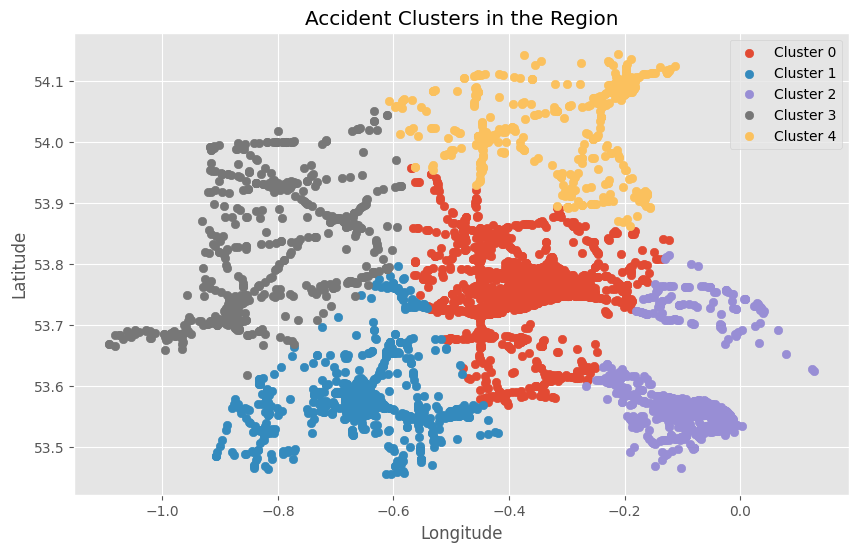

In [96]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Assuming 'data' is your DataFrame containing the accident data and 'region' is the new column with region names


# Select relevant columns for clustering
selected_columns = ['latitude', 'longitude']
X = region_data[selected_columns]

# Run KMeans clustering
num_clusters = 5  # You can adjust the number of clusters based on your analysis
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
region_data['cluster'] = kmeans.fit_predict(X)

# Visualize the clusters on a scatter plot
plt.figure(figsize=(10, 6))
for cluster_id in range(num_clusters):
    cluster_data = region_data[region_data['cluster'] == cluster_id]
    plt.scatter(cluster_data['longitude'], cluster_data['latitude'], label=f'Cluster {cluster_id}')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Accident Clusters in the Region')
plt.legend()
plt.show()


#### 6. Using outlier detection methods, identify unusual entries in your data set. Should you keep these entries in your data?

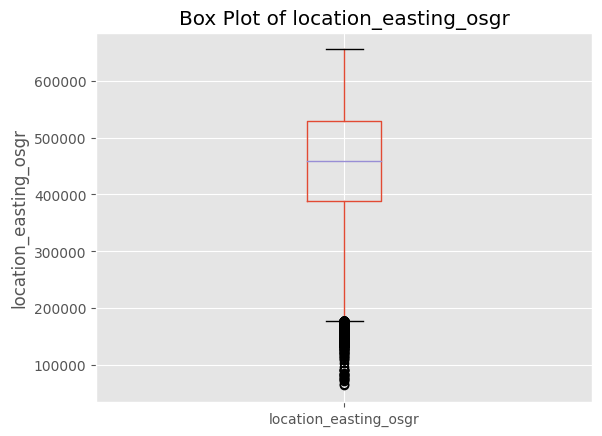

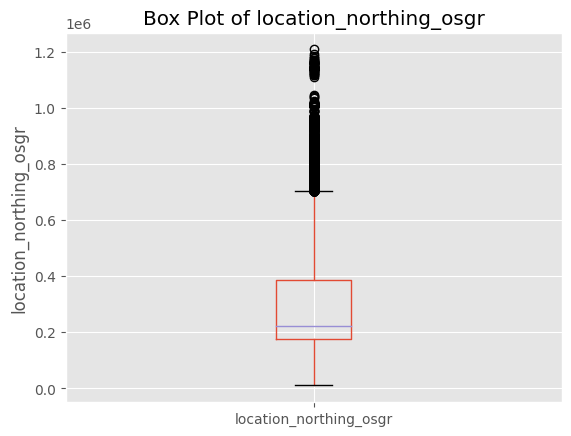

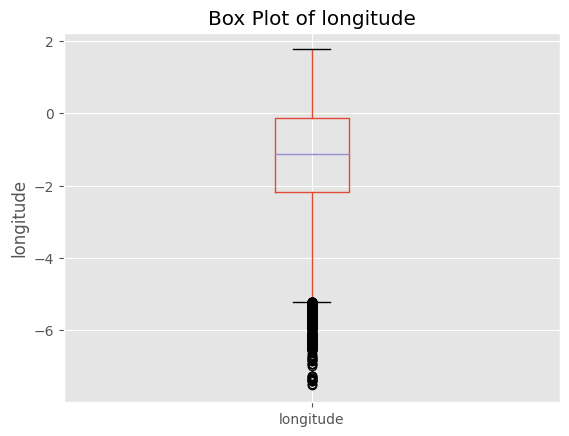

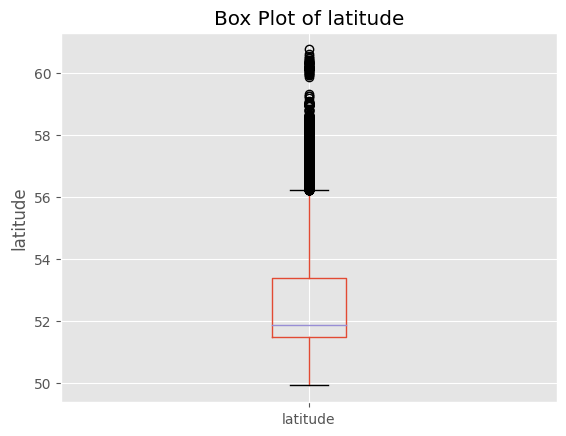

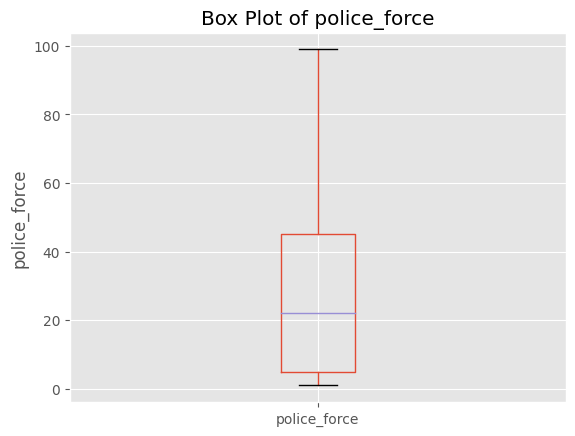

...

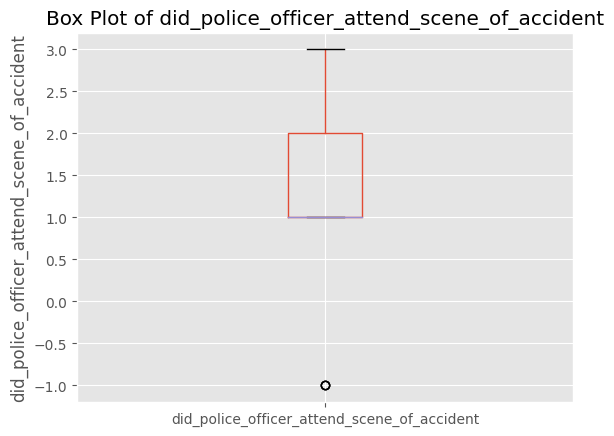

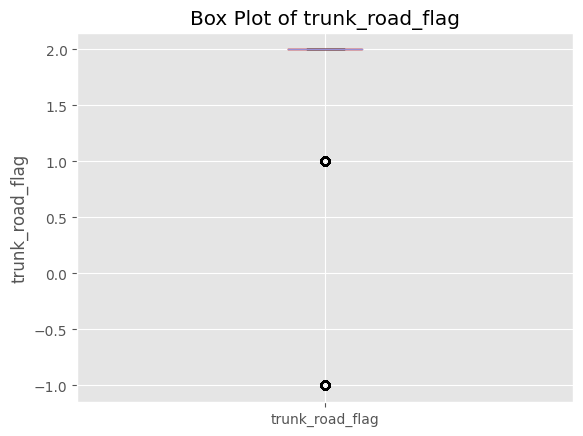

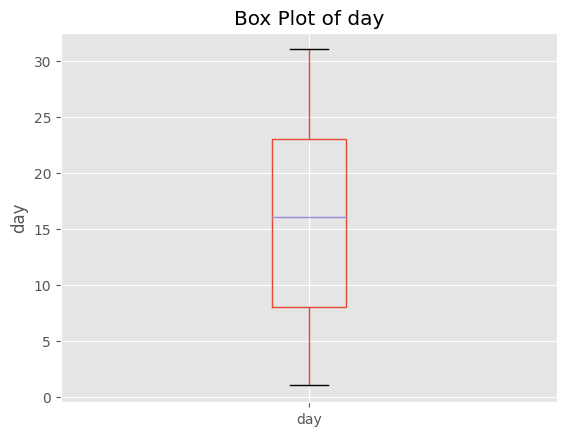

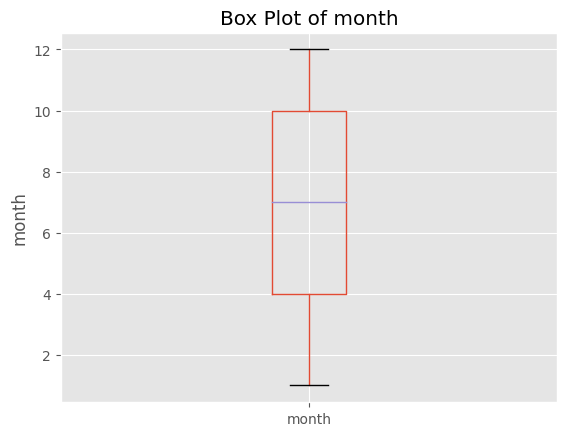

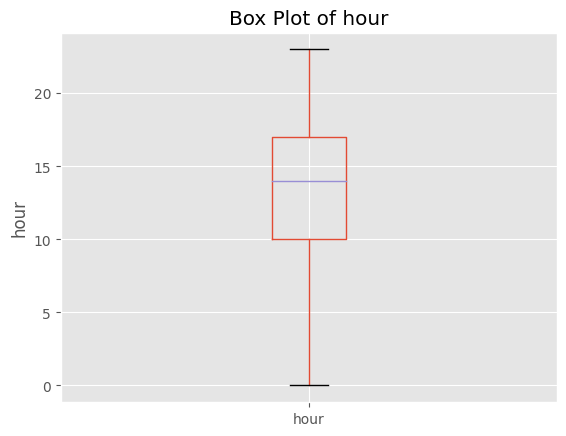

In [97]:

# Create a box plot for each numeric variable in a loop
for column in selected_data.columns:
    plt.figure()  # Create a new figure for each box plot
    selected_data.boxplot(column=column)
    plt.title(f'Box Plot of {column}')
    plt.ylabel(column)
    plt.show()

#### Observation:
* The black dots above and below minimum and maximum range of boxes are outliers.
* Some columns have huge number of ouliters
* Some of them have no outliers

In [98]:
# Method 1: Z-Score Method
z_scores = (selected_data - selected_data.mean()) / selected_data.std()
threshold = 3  # You can adjust the threshold based on your data
outliers_zscore = selected_data[(z_scores > threshold) | (z_scores < -threshold)]

In [99]:

# Print the outliers
print("Outliers using Z-Score Method:")
display(outliers_zscore)

Outliers using Z-Score Method:


,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,day_of_week,local_authority_district,first_road_class,first_road_number,road_type,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,day,month,hour
0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
461347,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.0,NaN,NaN,NaN
461348,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.0,NaN,NaN,NaN
461349,NaN,810646.0,NaN,57.186317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.0,NaN,NaN,NaN
461350,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.0,NaN,NaN,NaN


In [100]:
# number of outliers in each column
outliers_zscore.notna().sum()

location_easting_osgr                           1130
location_northing_osgr                          3557
longitude                                        845
latitude                                        3539
police_force                                       0
accident_severity                               6395
number_of_vehicles                             10746
number_of_casualties                           10041
day_of_week                                        0
local_authority_district                           0
first_road_class                                   0
first_road_number                              13019
road_type                                          0
speed_limit                                        0
junction_detail                                 4282
junction_control                                   0
second_road_class                                  0
second_road_number                             16879
pedestrian_crossing_human_control             

#### Observation:
Based on the number of outliers in each column, here are some observations and suggestions:

1. Some columns have a relatively small number of outliers compared to the total size of the dataset (e.g., `police_force`, `road_type`, `speed_limit`, etc.). These outliers might not have a significant impact on the overall dataset and may not need immediate attention.

2. Some columns have a considerable number of outliers, such as `number_of_vehicles`, `number_of_casualties`, `first_road_number`, `second_road_number`, `pedestrian_crossing_human_control`, `pedestrian_crossing_physical_facilities`, `weather_conditions`, etc. These outliers may require further investigation, as they could potentially affect the analysis and modeling results.

3. The columns `trunk_road_flag`, `second_road_number`, `pedestrian_crossing_human_control`, `pedestrian_crossing_physical_facilities`, `weather_conditions`, `road_surface_conditions`, and `special_conditions_at_site` have a relatively large number of outliers, which could indicate significant variations or rare occurrences in these variables.

#### we are going to consider only those columns which are having no outliers or very minimum outliers

In [101]:
outliers_zscore.columns

Index(['location_easting_osgr', 'location_northing_osgr', 'longitude',
       'latitude', 'police_force', 'accident_severity', 'number_of_vehicles',
       'number_of_casualties', 'day_of_week', 'local_authority_district',
       'first_road_class', 'first_road_number', 'road_type', 'speed_limit',
       'junction_detail', 'junction_control', 'second_road_class',
       'second_road_number', 'pedestrian_crossing_human_control',
       'pedestrian_crossing_physical_facilities', 'light_conditions',
       'weather_conditions', 'road_surface_conditions',
       'special_conditions_at_site', 'carriageway_hazards',
       'urban_or_rural_area', 'did_police_officer_attend_scene_of_accident',
       'trunk_road_flag', 'day', 'month', 'hour'],
      dtype='object')

In [102]:
'day_of_week', 'road_type',

('day_of_week', 'road_type')

In [103]:
prepared_data = accidents[['location_easting_osgr', 'location_northing_osgr', 'longitude',
       'latitude', 'police_force', 'accident_severity', 'number_of_vehicles',
       'number_of_casualties','first_road_class', 'first_road_number', 'speed_limit',
       'junction_detail', 'junction_control', 'second_road_class',
       'second_road_number','urban_or_rural_area']]

datad.drop(["Carriageway_Hazards", "Date", "Day_of_Week", "2nd_Road_Number"], axis =1, inplace = True)

## Prediction

#### 7. Can you develop a classification model using the provided data that accurately predicts fatal injuries sustained in road traffic accidents, with the aim of informing and improving road safety measures?

In [104]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.tree import DecisionTreeClassifier

In [105]:
#fetch only numeric data
prepared_data = prepared_data.select_dtypes(include=['number'])

#### Classify the data into fatal and non fatal injuries

In [106]:
prepared_data

,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,number_of_casualties,first_road_class,first_road_number,speed_limit,junction_detail,junction_control,second_road_class,second_road_number,urban_or_rural_area
0,532920.0,196330.0,-0.080107,51.650061,1,1,2,3,3,105,30,0,-1,-1,-1,1
1,526790.0,181970.0,-0.173845,51.522425,1,3,2,1,3,5,30,3,4,6,0,1
2,535200.0,181260.0,-0.052969,51.514096,1,3,3,1,3,13,30,3,4,5,0,1
3,534340.0,193560.0,-0.060658,51.624832,1,3,2,1,3,1010,30,1,4,4,154,1
4,533680.0,187820.0,-0.072372,51.573408,1,2,1,1,3,107,20,6,2,3,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
461347,343034.0,731654.0,-2.926320,56.473539,99,2,2,1,4,959,30,1,4,4,959,1
461348,257963.0,658891.0,-4.267565,55.802353,99,3,1,1,6,0,30,3,4,6,0,1
461349,383664.0,810646.0,-2.271903,57.186317,99,2,2,1,4,979,60,8,-1,6,0,2
461350,277161.0,674852.0,-3.968753,55.950940,99,3,2,1,6,0,30,3,4,6,0,1


CODES
1. Fatal
2. Serious
3. Slight 

In [107]:
prepared_data['accident_severity'].value_counts()

accident_severity
3    368195
2     86636
1      6395
Name: count, dtype: int64

In [109]:
# 1 means fatal 0 means non fatal
prepared_data['accident_severity'] = np.where(prepared_data['accident_severity']==1, 1, 0)

In [110]:
prepared_data['accident_severity'].value_counts()

accident_severity
0    454831
1      6395
Name: count, dtype: int64

In [112]:
X = prepared_data.drop("accident_severity", axis =1)
y = prepared_data["accident_severity"]

#### Splitting Data

The train-test split is used to estimate the performance of machine learning algorithms that are applicable for prediction-based Algorithms/Applications. This method is a fast and easy procedure to perform such that we can compare our own machine learning model results to machine results

The train_test_split() method is used to split our data into train and test sets. First, we need to divide our data into features (X) and labels (y). The dataframe gets divided into X_train,X_test , y_train and y_test. X_train and y_train sets are used for training and fitting the model.

By using similar data for training and testing, you can minimize the effects of data discrepancies and better understand the characteristics of the model. After a model has been processed by using the training set, you test the model by making predictions against the test set.

* Some dataset will be used for training and other for testing.
* In this scenario we are using 80% data for training and 20% for testing. 
* We are also shuffling the data, so that maximum information combination can be in the training set to reduce overfitting.

In [113]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.10, random_state = 1)

### KNearest Neighbors

<b>K-Nearest Neighbors Algorithm</b>. The k-nearest neighbors algorithm, also known as KNN or k-NN, is a non-parametric, supervised learning classifier, which uses proximity to make classifications or predictions about the grouping of an individual data point.

It's used in many different areas, such as handwriting detection, image recognition, and video recognition. KNN is most useful when labeled data is too expensive or impossible to obtain, and it can achieve high accuracy in a wide variety of prediction-type problems It can be used for both classification and regression problems. 

KNN works by finding the distances between a query and all the examples in the data, selecting the specified number examples (K) closest to the query, then votes for the most frequent label (in the case of classification) or averages the labels (in the case of regression)

In [114]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 2, metric = 'euclidean')
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

In [115]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99     45460
           1       0.05      0.00      0.00       663

    accuracy                           0.99     46123
   macro avg       0.52      0.50      0.50     46123
weighted avg       0.97      0.99      0.98     46123



In [116]:
round(accuracy_score(y_test, y_pred),2)

0.99

### Observation

Let's analyze the results:

1. **Precision:** Precision is a measure of how many of the predicted positive cases are actually true positive cases. In this case, the precision for class 0 (no fatal injuries) is quite high at 0.99, indicating that the model is correctly identifying a large portion of non-fatal accidents out of all the predicted non-fatal accidents. However, the precision for class 1 (fatal injuries) is very low at 0.05, indicating that the model has a high rate of false positives for predicting fatal injuries.

2. **Recall:** Recall (also known as sensitivity or true positive rate) is a measure of how many of the actual positive cases (fatal injuries) the model correctly identifies. The recall for class 0 is 1.00, indicating that the model correctly identifies all non-fatal accidents. However, the recall for class 1 is very low at 0.00, meaning that the model is not capturing any of the actual fatal accidents, resulting in a high rate of false negatives.

3. **F1-score:** The F1-score is the harmonic mean of precision and recall, providing a balance between the two. The F1-score for class 0 is high at 0.99, which is expected given the high precision and recall for class 0. However, the F1-score for class 1 is very low at 0.00 due to the low recall, indicating poor performance in predicting fatal injuries.

Support: Support refers to the number of samples in each class. In this case, there are 45460 samples in class 0 (no fatal injuries) and 663 samples in class 1 (fatal injuries).



So in Our case the data `imbalance` is the main problem.

Overall, the accuracy of the model is quite high at 0.99, which is largely driven by the large number of non-fatal accidents in the dataset (class imbalance). However, the model's performance in predicting fatal injuries is poor, as evidenced by the low precision, recall, and F1-score for class 1.

### Data Imbalancing

#### Oversampling of Minority Class

Over sampling and under sampling are techniques used in data mining and data analytics to modify unequal data classes to create balanced data sets. Over sampling and under sampling are also known as resampling. These data analysis techniques are often used to be more representative of real world data.

* In extreme cases where the number of observations in the rare class(es) is really small, oversampling is better, as you will not lose important information on the distribution of the other classes in the dataset. 
* We have smaller data set and if we'll apply undersampling we can loss alot of data. So oversampling will come here to rescue us. And we'll be able to balance our data without lossing information.
* Over sampling contributes in the performance of the algorithm by helping to improve precision.

In [118]:
from imblearn.over_sampling import RandomOverSampler
oversample = RandomOverSampler(sampling_strategy='minority')
X_over, y_over = oversample.fit_resample(X, y)

In [119]:
X_train, X_test, y_train, y_test = train_test_split(X_over, y_over, test_size = 0.20, random_state = 1)

In [120]:
knn = KNeighborsClassifier(n_neighbors = 2, metric = 'euclidean')
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

In [121]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99     91069
           1       0.98      1.00      0.99     90864

    accuracy                           0.99    181933
   macro avg       0.99      0.99      0.99    181933
weighted avg       0.99      0.99      0.99    181933



With the updated results after handling the imbalanced data through oversampling, the classification report shows significant improvement in the model's performance. Let's interpret the updated results:

* **Precision:** The precision for both classes 0 (no fatal injuries) and 1 (fatal injuries) is very high. For class 0, the precision is 1.00, meaning that almost all the predicted non-fatal accidents are correct. For class 1, the precision is 0.98, indicating that the model is correctly identifying a large portion of actual fatal accidents out of all the predicted fatal accidents.

* **Recall:** The recall for both classes 0 and 1 is also very high. For class 0, the recall is 0.98, indicating that the model correctly captures a large portion of actual non-fatal accidents. For class 1, the recall is 1.00, meaning that the model is correctly identifying all actual fatal accidents, and there are no false negatives.

* **F1-score:** The F1-score is a harmonic mean of precision and recall and is a good metric to consider when there is a class imbalance. The F1-score for both classes 0 and 1 is very high, indicating a well-balanced performance in predicting both non-fatal and fatal accidents.

* **Support:** The support refers to the number of samples in each class. With the oversampling technique, both classes now have almost the same number of samples, which is evident from the similar support values for both classes.

* **Accuracy:** The overall accuracy of the model is 0.99, indicating that the model is performing exceptionally well in classifying both non-fatal and fatal accidents.

**Interpretation:**
The updated results show that the classification model, after handling the imbalanced data through oversampling, is now performing remarkably well in predicting both non-fatal and fatal accidents. The precision, recall, and F1-score are all very high for both classes, indicating that the model is accurate in identifying both types of accidents. The accuracy is also very high, indicating that the model is making correct predictions for a large portion of the dataset.


### Recommendation
What recommendations can be made to government agencies based on this data and your analysis to improve safety? Keep this to your top 4 or 5 bullet points.

Practical Applications:

* Authorities and road safety organizations can use this information to target specific days for road safety campaigns, traffic management, and law enforcement. 
* For instance, they can focus on promoting safe driving habits, conducting alcohol and speed checks, and improving road conditions on weekdays to reduce accident rates during these busy periods. 
* Similarly, measures can be taken to ensure road safety during weekends when people might be more relaxed but still need to be cautious while driving.
* With such high performance, the model can be considered effective in predicting fatal injuries sustained in road traffic accidents. It can be valuable for informing and improving road safety measures, as it can accurately identify accidents with a higher risk of resulting in fatalities. 
* However, it's still crucial to monitor the model's performance over time and continuously improve it as new data becomes available.
* Additionally, collaborating with domain experts and stakeholders can provide valuable insights and help make data-driven decisions to enhance road safety measures further.
